Hello, welcome to this final project of mine for Kadenze's Creative Applications with Tensorflow. While I wrestle getting some of the more complex networks under control, I will share and hopefully extend a simple method I thought of to get better results out of the 'guided hallucinations' exercise. Besides this simple method, all the credit goes to Parag Mital.

It's a very simple trick really. Basically, I was curious how the result would come out when combining two similar images which are something like mirror opposites - for example, a coastal town on the left of an image with the beach and ocean on the right, and a coastal town on the right of an image with the beach and ocean on the left. The initial results with the stock code weren't very impressive - the combination was more or less a mess with the guide image looking like digital melted plastic over the dream image.

So what I did was alternate the guide and dream images each iteration, so the style and content was balanced weight-wise between both images, instead of being entirely separately weighted against each other. The result was much more interesting, though I left it to be refined further. 

After this, I focused on the style transfer network from the course, again applying this same trick, making it kind of a style/content swap, or alternation

The first handful of examples focus on using this swap (or conflation) technique for the deep dream network, while the last examples focus on style/content transfer. The latter is possibly the more intriguing, at least to me.

In [1]:
# load and start (copied from Mital)

# First check the Python version
import sys
if sys.version_info < (3,4):
    print('You are running an older version of Python!\n\n',
          'You should consider updating to Python 3.4.0 or',
          'higher as the libraries built for this course',
          'have only been tested in Python 3.4 and higher.\n')
    print('Try installing the Python 3.5 version of anaconda'
          'and then restart `jupyter notebook`:\n',
          'https://www.continuum.io/downloads\n\n')

# Now get necessary libraries
try:
    import os
    import numpy as np
    import matplotlib.pyplot as plt
    from skimage.transform import resize
    from skimage import data
    from scipy.misc import imresize
    from scipy.ndimage.filters import gaussian_filter
    import IPython.display as ipyd
    import tensorflow as tf
    from libs import utils, gif, datasets, dataset_utils, vae, dft, vgg16, nb_utils
except ImportError:
    print("Make sure you have started notebook in the same directory",
          "as the provided zip file which includes the 'libs' folder",
          "and the file 'utils.py' inside of it.  You will NOT be able",
          "to complete this assignment unless you restart jupyter",
          "notebook inside the directory created by extracting",
          "the zip file or cloning the github repo.  If you are still")

# We'll tell matplotlib to inline any drawn figures like so:
%matplotlib inline
plt.style.use('ggplot')

# Bit of formatting because I don't like the default inline code style:
from IPython.core.display import HTML
HTML("""<style> .rendered_html code { 
    padding: 2px 4px;
    color: #c7254e;
    background-color: #f9f2f4;
    border-radius: 4px;
} </style>""")

In [206]:
tf.reset_default_graph()

In [86]:
net = vgg16.get_vgg_model()

assert(net['labels'][0] == (0, 'n01440764 tench, Tinca tinca'))

In [59]:
print(net.keys())

dict_keys(['deprocess', 'labels', 'preprocess', 'graph_def'])


In [207]:
# original code provided by Mital

device = '/cpu:0'

# We'll now explicitly create a graph
g = tf.Graph()

with tf.Session(graph=g) as sess, g.device(device):
    
    # Now load the graph_def, which defines operations and their values into `g`
    tf.import_graph_def(net['graph_def'], name='net')

names = [op.name for op in g.get_operations()]
print(names)

['net/images', 'net/mul/y', 'net/mul', 'net/split/split_dim', 'net/split', 'net/sub/y', 'net/sub', 'net/sub_1/y', 'net/sub_1', 'net/sub_2/y', 'net/sub_2', 'net/concat/concat_dim', 'net/concat', 'net/conv1_1/filter', 'net/conv1_1/Conv2D', 'net/conv1_1/biases', 'net/conv1_1/BiasAdd', 'net/conv1_1/conv1_1', 'net/conv1_2/filter', 'net/conv1_2/Conv2D', 'net/conv1_2/biases', 'net/conv1_2/BiasAdd', 'net/conv1_2/conv1_2', 'net/pool1', 'net/conv2_1/filter', 'net/conv2_1/Conv2D', 'net/conv2_1/biases', 'net/conv2_1/BiasAdd', 'net/conv2_1/conv2_1', 'net/conv2_2/filter', 'net/conv2_2/Conv2D', 'net/conv2_2/biases', 'net/conv2_2/BiasAdd', 'net/conv2_2/conv2_2', 'net/pool2', 'net/conv3_1/filter', 'net/conv3_1/Conv2D', 'net/conv3_1/biases', 'net/conv3_1/BiasAdd', 'net/conv3_1/conv3_1', 'net/conv3_2/filter', 'net/conv3_2/Conv2D', 'net/conv3_2/biases', 'net/conv3_2/BiasAdd', 'net/conv3_2/conv3_2', 'net/conv3_3/filter', 'net/conv3_3/Conv2D', 'net/conv3_3/biases', 'net/conv3_3/BiasAdd', 'net/conv3_3/conv3_

In [88]:
features = [name + ':0' for name in names if 'pool' in name.split('/')[-1]]

# Let's print them
print(features)

['net/pool1:0', 'net/pool2:0', 'net/pool3:0', 'net/pool4:0', 'net/pool5:0']


First, we'll load the two 'mirror-like' images and run the original guided hallucination code so we can compare further experimentation with the baseline result. Again, this is so far is straight from the exercise

255


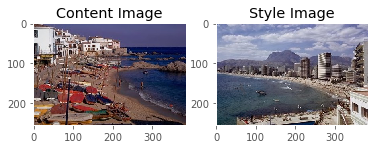

In [193]:
content_og = plt.imread('116.jpg')[..., :3]
style_og = plt.imread('118.jpg')[..., :3]

fig, axs = plt.subplots(1, 2)
axs[0].imshow(content_og)
axs[0].set_title('Content Image')
axs[0].grid('off')
axs[1].imshow(style_og)
axs[1].set_title('Style Image')
axs[1].grid('off')

# We'll save these with a specific name to include in your submission
plt.imsave(arr=content_og, fname='content.png')
plt.imsave(arr=style_og, fname='style.png')
print(style_og.max())

In [194]:
content_img = net['preprocess'](content_og)[np.newaxis]
style_img = net['preprocess'](style_og)[np.newaxis]

/Users/jonathansherman/anaconda3/lib/python3.5/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


In [208]:
# Grab the tensor defining the input to the network
x = g.get_tensor_by_name(names[0] + ':0')

# And grab the tensor defining the softmax layer of the network
softmax = g.get_tensor_by_name(names[-2] + ':0')

# Remember from the lecture that we have to set the dropout
# "keep probability" to 1.0.
keep_probability = np.ones([1, 4096])

for img in [content_img, style_img]:
    with tf.Session(graph=g) as sess, g.device('/cpu:0'):
        res = softmax.eval(feed_dict={x: img,
                    'net/dropout_1/random_uniform:0': keep_probability,
                    'net/dropout/random_uniform:0': keep_probability})[0]
        print([(res[idx], net['labels'][idx])
               for idx in res.argsort()[-5:][::-1]])

[(0.99997115, (978, 'n09428293 seashore, coast, seacoast, sea-coast')), (2.7199183e-05, (536, 'n03216828 dock, dockage, docking facility')), (1.5437199e-06, (975, 'n09332890 lakeside, lakeshore')), (6.2098877e-08, (976, 'n09399592 promontory, headland, head, foreland')), (3.1931091e-08, (628, 'n03673027 liner, ocean liner'))]
[(0.99965119, (978, 'n09428293 seashore, coast, seacoast, sea-coast')), (0.00029047826, (976, 'n09399592 promontory, headland, head, foreland')), (4.1199681e-05, (460, 'n02894605 breakwater, groin, groyne, mole, bulwark, seawall, jetty')), (1.6306285e-05, (975, 'n09332890 lakeside, lakeshore')), (3.9565725e-07, (977, 'n09421951 sandbar, sand bar'))]


In [209]:
# Experiment w/ different layers here.  You'll need to change this if you 
# use another network!
content_layer = 'net/conv3_2/conv3_2:0'

# MIX THE IMAGES HERE
content_mix = (content_img+style_img)/2

print(content_mix)

with tf.Session(graph=g) as sess, g.device('/cpu:0'):
    content_features = g.get_tensor_by_name(content_layer).eval(
            session=sess,
            feed_dict={x: content_mix,
                    'net/dropout_1/random_uniform:0': keep_probability,
                    'net/dropout/random_uniform:0': keep_probability})

[[[[ 0.46352541  0.48456383  0.64589834]
   [ 0.44023609  0.45984393  0.62645054]
   [ 0.41193479  0.43294317  0.59992999]
   ..., 
   [ 0.46816728  0.46438575  0.60976392]
   [ 0.46784714  0.46406564  0.60944378]
   [ 0.46739697  0.46361545  0.60899359]]

  [[ 0.46516609  0.48068225  0.64286715]
   [ 0.43104243  0.44980991  0.61497599]
   [ 0.41885757  0.43872547  0.60092038]
   ..., 
   [ 0.49160665  0.48964584  0.63866544]
   [ 0.48598439  0.48402363  0.63304323]
   [ 0.47902161  0.47706085  0.62686074]]

  [[ 0.46451581  0.47703081  0.63668466]
   [ 0.41967788  0.43451381  0.59630853]
   [ 0.4192577   0.43354341  0.5969888 ]
   ..., 
   [ 0.50417167  0.50431174  0.65403163]
   [ 0.49301723  0.49315727  0.64287716]
   [ 0.48333335  0.48347339  0.63553423]]

  ..., 
  [[ 0.67785114  0.61711681  0.55366147]
   [ 0.65358144  0.58510405  0.51786715]
   [ 0.59559822  0.51839733  0.43884555]
   ..., 
   [ 0.2195078   0.18331333  0.18074229]
   [ 0.16438575  0.12909164  0.12855142]
   [ 0.

In [210]:
# Experiment with different layers and layer subsets.  You'll need to change these
# if you use a different network!
style_layers = ['net/conv1_1/conv1_1:0',
                'net/conv1_2/filter:0',
                'net/conv2_1/Conv2D:0',
                'net/conv2_2/BiasAdd:0',
                'net/conv3_1/conv3_1:0',
                'net/conv3_2/filter:0',
                'net/conv3_3/Conv2D:0',
                'net/conv4_1/BiasAdd:0',
                'net/conv4_2/conv4_2:0',
                'net/conv4_3/filter:0',
                'net/conv5_1/Conv2D:0',
                'net/conv5_2/BiasAdd:0',
                'net/conv5_3/conv5_3:0']

# Experiment with reversing layers
#style_layers = style_layers[::-1]

style_activations = []

with tf.Session(graph=g) as sess, g.device('/cpu:0'):
    for idx_i, style_i in enumerate(style_layers):
        if idx_i%2 == 0:
            style_activation_i = g.get_tensor_by_name(style_i).eval(
                feed_dict={x: content_img,
                        'net/dropout_1/random_uniform:0': keep_probability,
                        'net/dropout/random_uniform:0': keep_probability})
            style_activations.append(style_activation_i)
        else:
            style_activation_i = g.get_tensor_by_name(style_i).eval(
                feed_dict={x: style_img,
                        'net/dropout_1/random_uniform:0': keep_probability,
                        'net/dropout/random_uniform:0': keep_probability})
            style_activations.append(style_activation_i)
            

In [211]:
style_features = []
for style_activation_i in style_activations:
    s_i = np.reshape(style_activation_i, [-1, style_activation_i.shape[-1]])
    gram_matrix = np.matmul(s_i.T, s_i) / s_i.size
    style_features.append(gram_matrix.astype(np.float32))

In [212]:
g = tf.Graph()

# Get the network again
net = vgg16.get_vgg_model()

# Load up a session which we'll use to import the graph into.
with tf.Session(graph=g) as sess, g.device('/cpu:0'):
    # We can set the `net_input` to our content image
    # or perhaps another image
    # or an image of noise
    # perhaps not surprisingly, seems noise affects form where image-based input is more coloration
    
    #HERE EXPERIMENT WITH INCLUDING NORMALIZATION OF BOTH IMAGES, OR JUST ONE
    #THE EXAMPLES C AND D IN THE GIFS BELOW USE THE FOLLOWING CALCULATION
    net_input = (tf.Variable(content_img / (np.std(content_img) / np.mean(content_img)) + 1e-8) + tf.Variable(style_img / (np.std(style_img) / np.mean(style_img)) + 1e-8))/2
    
    #net_input = tf.Variable(content_img / 255.0)
    #net_input = tf.Variable(content_img / (np.std(content_img) / np.mean(content_img)) + 1e-8)
    #net_input = tf.get_variable(
       #name='input',
       #shape=content_img.shape,
       #dtype=tf.float32,
       #initializer=tf.random_normal_initializer(
           #mean=np.mean(content_img), stddev=np.std(content_img)))
    
    # Now we load the network again, but this time replacing our placeholder
    # with the trainable tf.Variable
    tf.import_graph_def(
        net['graph_def'],
        name='net',
        input_map={'images:0': net_input})

In [213]:
with tf.Session(graph=g) as sess, g.device('/cpu:0'):
    content_loss = tf.nn.l2_loss((g.get_tensor_by_name(content_layer) -
                                 content_features) /
                                 content_features.size)

In [214]:
with tf.Session(graph=g) as sess, g.device('/cpu:0'):
    style_loss = np.float32(0.0)
    for style_layer_i, style_gram_i in zip(style_layers, style_features):
        layer_i = g.get_tensor_by_name(style_layer_i)
        layer_shape = layer_i.get_shape().as_list()
        layer_size = layer_shape[1] * layer_shape[2] * layer_shape[3]
        layer_flat = tf.reshape(layer_i, [-1, layer_shape[3]])
        gram_matrix = tf.matmul(tf.transpose(layer_flat), layer_flat) / layer_size
        style_loss = tf.add(style_loss, tf.nn.l2_loss((gram_matrix - style_gram_i) / np.float32(style_gram_i.size)))

In [215]:
def total_variation_loss(x):
    h, w = x.get_shape().as_list()[1], x.get_shape().as_list()[1]
    dx = tf.square(x[:, :h-1, :w-1, :] - x[:, :h-1, 1:, :])
    dy = tf.square(x[:, :h-1, :w-1, :] - x[:, 1:, :w-1, :])
    return tf.reduce_sum(tf.pow(dx + dy, 1.25))

with tf.Session(graph=g) as sess, g.device('/cpu:0'):
    tv_loss = total_variation_loss(net_input)

In [216]:
with tf.Session(graph=g) as sess, g.device('/cpu:0'):
    # Experiment w/ the weighting of these!  They produce WILDLY different
    # results. Most flatten early though. Best separated up top. 
    #loss = 2.5 * content_loss + 2.5 * style_loss + 0.001 * tv_loss #painter-like reality w/some double-imaging
    #loss = ((content_loss+tv_loss)*(style_loss+tv_loss)) / (tv_loss*2) # expansion blur and then reformation effect
    loss = (content_loss * style_loss) + content_loss + style_loss # retains more realistic form
    
    #loss = ((content_loss * style_loss * tv_loss)*tv_loss) / (tv_loss + content_loss + style_loss) # retains more realistic form
    #loss = (((content_loss+tv_loss)*(style_loss+tv_loss)) * (tv_loss)) / (((content_loss+tv_loss)*(style_loss+tv_loss)) / tv_loss) # expansion blur and then sharp error drop
    #loss = (((content_loss*tv_loss)+(style_loss*tv_loss)) * (tv_loss)) / (((content_loss+tv_loss)*(style_loss+tv_loss)) / tv_loss) # expansion blur and then sharp error drop
    
    #loss = ((tv_loss*tv_loss)*2 / ((content_loss*content_loss)-(style_loss*style_loss))*2) + tv_loss # destructive effacing
    #loss = ((content_loss * content_loss) + (style_loss * style_loss)) / (tv_loss * tv_loss) #blotchy colors retains outlines
    #loss = tv_loss / content_loss*style_loss # psychedelic
    #loss = ((content_loss+tv_loss) * (style_loss+tv_loss)) / content_loss*style_loss*tv_loss # psychedelic
    #loss = ((content_loss*tv_loss)*(style_loss*tv_loss)) / (tv_loss*tv_loss) # effaces but overlaps 
    #loss = (content_loss * style_loss * tv_loss) / (content_loss+style_loss) # soft blur retains form but overlaps
    #loss = (content_loss * style_loss * tv_loss) / (content_loss+style_loss)+tv_loss # expansion blur
    #loss = (content_loss * style_loss * tv_loss) / content_loss + style_loss #less expansive blur
    optimizer = tf.train.AdamOptimizer(0.05).minimize(loss)

0: 259.887024, (0.012056 - 1.954720)


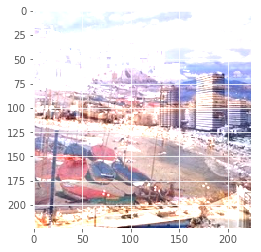

1: 120.308434, (-0.021016 - 1.938006)
2: 75.772224, (0.013372 - 1.946881)
3: 56.426422, (0.050454 - 1.962992)
4: 46.527565, (0.086531 - 1.958749)
5: 41.048679, (0.089425 - 1.941708)


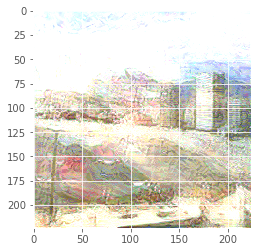

6: 37.800152, (0.076012 - 1.918069)
7: 35.664509, (0.046469 - 1.928459)
8: 34.129719, (0.019601 - 1.940701)
9: 32.845333, (-0.003859 - 1.948932)
10: 31.589935, (-0.031677 - 1.953839)


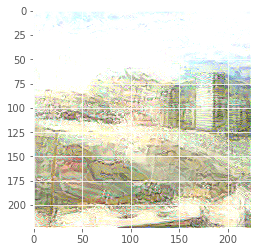

11: 30.279934, (-0.066997 - 1.955457)
12: 28.884266, (-0.099963 - 1.954709)
13: 27.434889, (-0.127389 - 1.952626)
14: 25.986048, (-0.146611 - 1.949711)
15: 24.563013, (-0.159300 - 1.945863)


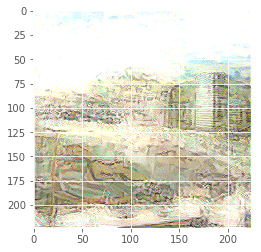

16: 23.202314, (-0.167192 - 1.940647)
17: 21.924995, (-0.171662 - 1.934538)
18: 20.752129, (-0.174400 - 1.927719)
19: 19.684284, (-0.177170 - 1.923107)
20: 18.703741, (-0.192965 - 1.949766)


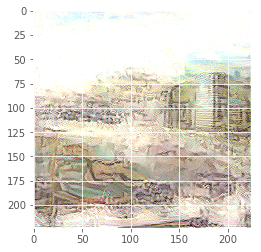

21: 17.803015, (-0.213824 - 1.975609)
22: 16.981516, (-0.233904 - 2.001157)
23: 16.231031, (-0.250470 - 2.025811)
24: 15.545265, (-0.261865 - 2.049134)
25: 14.913395, (-0.266840 - 2.070667)


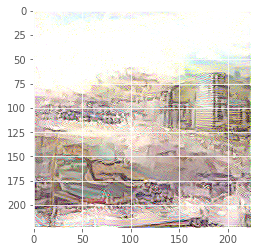

26: 14.326834, (-0.272034 - 2.090462)
27: 13.777633, (-0.284523 - 2.108547)
28: 13.261312, (-0.311521 - 2.125081)
29: 12.777113, (-0.339919 - 2.140194)
30: 12.322884, (-0.367333 - 2.154095)


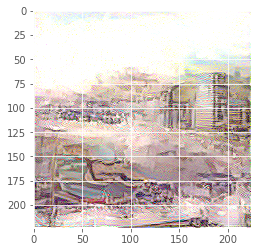

31: 11.896769, (-0.393014 - 2.166840)
32: 11.496660, (-0.416093 - 2.178877)
33: 11.120724, (-0.435442 - 2.190252)
34: 10.765444, (-0.451146 - 2.201015)
35: 10.429725, (-0.463425 - 2.210914)


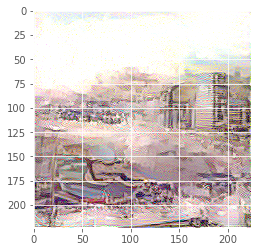

36: 10.113059, (-0.473226 - 2.219211)
37: 9.813306, (-0.483977 - 2.225187)
38: 9.529686, (-0.491443 - 2.228460)
39: 9.260760, (-0.496546 - 2.228823)
40: 9.005034, (-0.500842 - 2.226159)


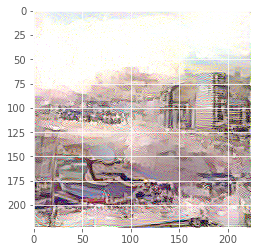

41: 8.761439, (-0.517383 - 2.221293)
42: 8.530229, (-0.550023 - 2.214510)
43: 8.311483, (-0.581535 - 2.206035)
44: 8.104009, (-0.610921 - 2.196136)
45: 7.907108, (-0.637067 - 2.185006)


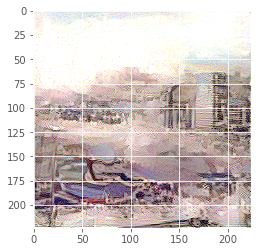

46: 7.720037, (-0.659601 - 2.173002)
47: 7.542157, (-0.678756 - 2.160279)
48: 7.373249, (-0.695035 - 2.146977)
49: 7.212353, (-0.708711 - 2.133520)
50: 7.058526, (-0.719726 - 2.120052)


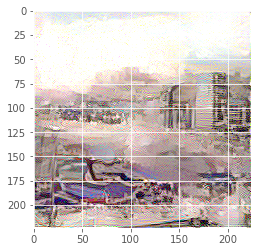

51: 6.911025, (-0.729681 - 2.106683)
52: 6.769907, (-0.738809 - 2.093664)
53: 6.634700, (-0.747043 - 2.081206)
54: 6.505177, (-0.754739 - 2.069527)
55: 6.380931, (-0.760853 - 2.058398)


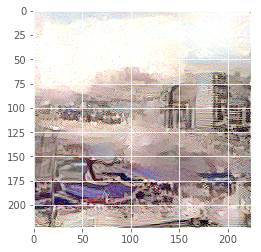

56: 6.261273, (-0.766279 - 2.047925)
57: 6.146190, (-0.770391 - 2.038151)
58: 6.035450, (-0.773219 - 2.029185)
59: 5.929128, (-0.775664 - 2.020901)
60: 5.826741, (-0.777142 - 2.013224)


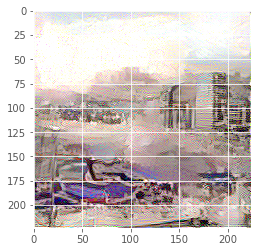

61: 5.728182, (-0.779972 - 2.006011)
62: 5.633087, (-0.790826 - 1.999349)
63: 5.541122, (-0.800647 - 1.993174)
64: 5.452263, (-0.810415 - 1.987451)
65: 5.366276, (-0.820206 - 1.982074)


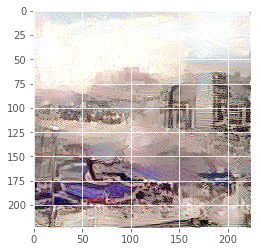

66: 5.283217, (-0.830520 - 1.977016)
67: 5.202871, (-0.840454 - 1.972218)
68: 5.125155, (-0.849740 - 1.967687)
69: 5.049826, (-0.858446 - 1.963439)
70: 4.976830, (-0.866459 - 1.959341)


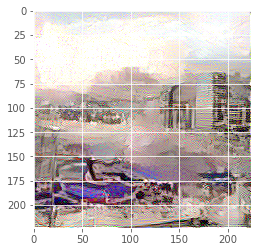

71: 4.906042, (-0.874065 - 1.955446)
72: 4.837353, (-0.881494 - 1.951660)
73: 4.770512, (-0.889235 - 1.948005)
74: 4.705395, (-0.897135 - 1.944414)
75: 4.642112, (-0.905021 - 1.940884)


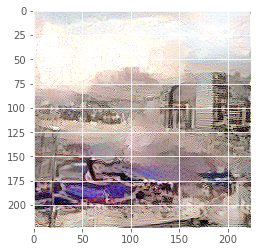

76: 4.580774, (-0.912152 - 1.937352)
77: 4.521132, (-0.917887 - 1.933606)
78: 4.463207, (-0.922082 - 1.929693)
79: 4.406866, (-0.925299 - 1.925722)
80: 4.352051, (-0.927754 - 1.921778)


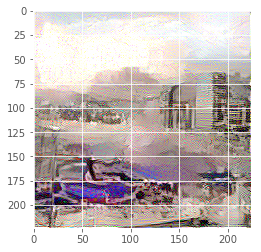

81: 4.298806, (-0.929536 - 1.917975)
82: 4.246940, (-0.930450 - 1.914318)
83: 4.196280, (-0.930355 - 1.910855)
84: 4.146782, (-0.929053 - 1.907534)
85: 4.098450, (-0.926435 - 1.904291)


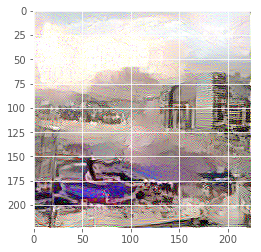

86: 4.051270, (-0.921347 - 1.901093)
87: 4.005195, (-0.915989 - 1.897920)
88: 3.960146, (-0.911999 - 1.894781)
89: 3.916041, (-0.908742 - 1.891673)
90: 3.872864, (-0.908373 - 1.888604)


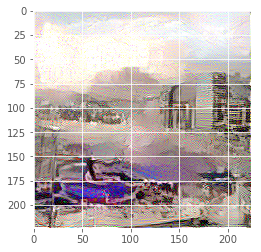

91: 3.830667, (-0.913854 - 1.885594)
92: 3.789426, (-0.921872 - 1.882810)
93: 3.749123, (-0.931018 - 1.880267)
94: 3.709716, (-0.939721 - 1.877929)
95: 3.671116, (-0.946591 - 1.875706)


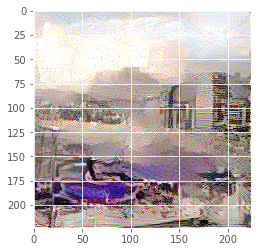

96: 3.633333, (-0.951757 - 1.875448)
97: 3.596296, (-0.953478 - 1.878691)
98: 3.560003, (-0.964168 - 1.881942)
99: 3.524415, (-0.976126 - 1.884994)
100: 3.489519, (-0.987667 - 1.887778)


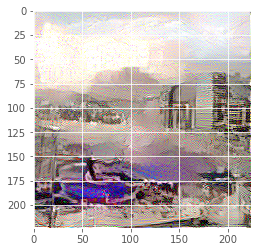

101: 3.455287, (-0.998998 - 1.890226)
102: 3.421732, (-1.009897 - 1.892012)
103: 3.388788, (-1.020437 - 1.892880)
104: 3.356498, (-1.030525 - 1.893034)
105: 3.324825, (-1.040339 - 1.892583)


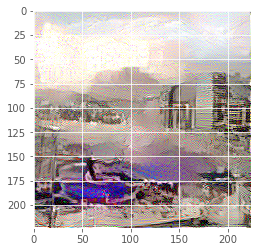

106: 3.293780, (-1.049525 - 1.892191)
107: 3.263370, (-1.058171 - 1.892102)
108: 3.233561, (-1.066350 - 1.892160)
109: 3.204338, (-1.073969 - 1.892162)
110: 3.175631, (-1.081331 - 1.891969)


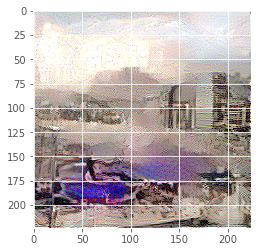

111: 3.147418, (-1.088843 - 1.891321)
112: 3.119728, (-1.096668 - 1.890252)
113: 3.092536, (-1.105364 - 1.888903)
114: 3.065845, (-1.115144 - 1.887654)
115: 3.039662, (-1.125869 - 1.886546)


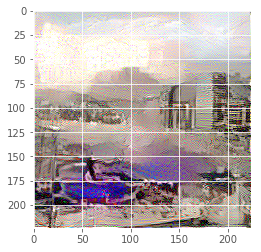

116: 3.014011, (-1.136755 - 1.885486)
117: 2.988806, (-1.147296 - 1.884521)
118: 2.964020, (-1.157056 - 1.883374)
119: 2.939688, (-1.165941 - 1.881874)
120: 2.915875, (-1.173703 - 1.880474)


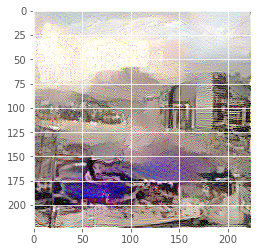

121: 2.892524, (-1.181193 - 1.879163)
122: 2.869606, (-1.188559 - 1.877816)
123: 2.847105, (-1.195905 - 1.876408)
124: 2.825020, (-1.203808 - 1.875477)
125: 2.803366, (-1.211923 - 1.875132)


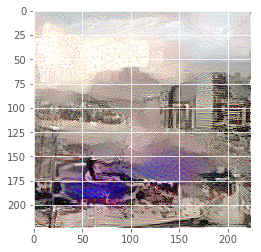

126: 2.782130, (-1.220287 - 1.875548)
127: 2.761318, (-1.228846 - 1.876501)
128: 2.740877, (-1.237760 - 1.877414)
129: 2.720771, (-1.246896 - 1.877470)
130: 2.701034, (-1.256034 - 1.876736)


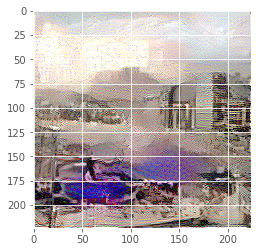

131: 2.681645, (-1.264841 - 1.875139)
132: 2.662598, (-1.273869 - 1.872943)
133: 2.643871, (-1.283132 - 1.869913)
134: 2.625472, (-1.292395 - 1.865942)
135: 2.607393, (-1.301425 - 1.861067)


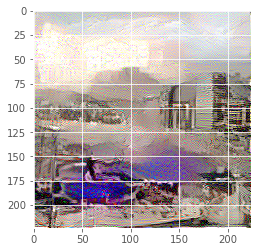

136: 2.589592, (-1.309729 - 1.855628)
137: 2.572090, (-1.317397 - 1.849598)
138: 2.554873, (-1.324378 - 1.843279)
139: 2.537947, (-1.331069 - 1.836738)
140: 2.521325, (-1.337848 - 1.830503)


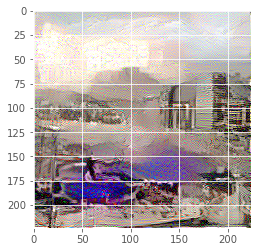

141: 2.505015, (-1.344959 - 1.825092)
142: 2.488975, (-1.352410 - 1.827093)
143: 2.473197, (-1.360155 - 1.830112)
144: 2.457650, (-1.367872 - 1.833236)
145: 2.442351, (-1.375406 - 1.836440)


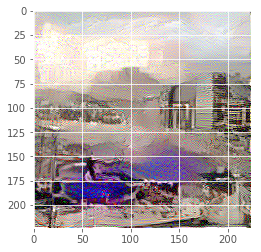

146: 2.427335, (-1.382414 - 1.839644)
147: 2.412584, (-1.389328 - 1.842839)
148: 2.398083, (-1.395655 - 1.846018)
149: 2.383802, (-1.401361 - 1.849185)
150: 2.369729, (-1.406851 - 1.852376)


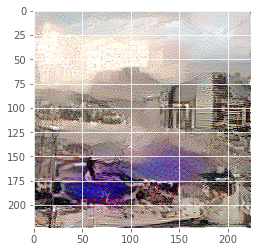

151: 2.355896, (-1.412449 - 1.855516)
152: 2.342303, (-1.418305 - 1.858508)
153: 2.328912, (-1.424171 - 1.861192)
154: 2.315744, (-1.429734 - 1.863564)
155: 2.302788, (-1.435070 - 1.865681)


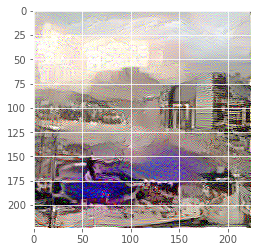

156: 2.290025, (-1.440710 - 1.867538)
157: 2.277444, (-1.446671 - 1.869170)
158: 2.265065, (-1.453054 - 1.870560)
159: 2.252879, (-1.460284 - 1.871705)
160: 2.240864, (-1.468178 - 1.872600)


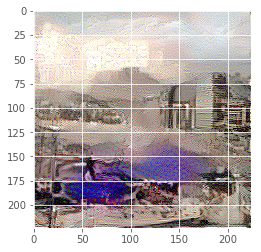

161: 2.229009, (-1.476399 - 1.873314)
162: 2.217320, (-1.484637 - 1.873908)
163: 2.205807, (-1.492397 - 1.874358)
164: 2.194452, (-1.499704 - 1.874631)
165: 2.183280, (-1.506861 - 1.874703)


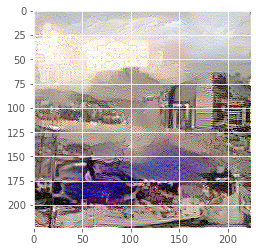

166: 2.172292, (-1.514339 - 1.874551)
167: 2.161470, (-1.522448 - 1.874414)
168: 2.150811, (-1.531235 - 1.874279)
169: 2.140302, (-1.541018 - 1.874102)
170: 2.129949, (-1.552069 - 1.873849)


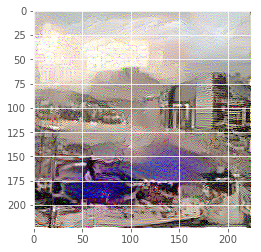

171: 2.119750, (-1.564180 - 1.873622)
172: 2.109693, (-1.577142 - 1.873417)
173: 2.099786, (-1.590912 - 1.873255)
174: 2.090033, (-1.604240 - 1.873124)
175: 2.080437, (-1.617030 - 1.873182)


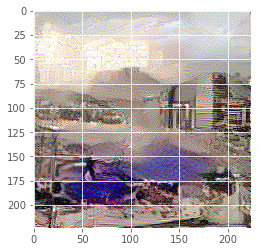

176: 2.070942, (-1.628845 - 1.873346)
177: 2.061578, (-1.639891 - 1.873634)
178: 2.052357, (-1.650176 - 1.874091)
179: 2.043272, (-1.659898 - 1.874352)
180: 2.034311, (-1.669186 - 1.874464)


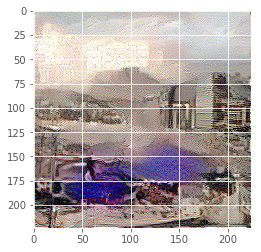

181: 2.025486, (-1.678197 - 1.874451)
182: 2.016774, (-1.686697 - 1.874300)
183: 2.008189, (-1.695081 - 1.874215)
184: 1.999730, (-1.703499 - 1.874228)
185: 1.991371, (-1.711646 - 1.874300)


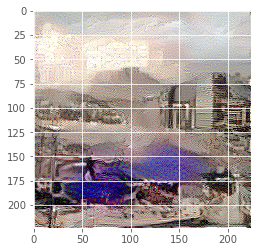

186: 1.983114, (-1.719409 - 1.874336)
187: 1.974969, (-1.726722 - 1.874065)
188: 1.966928, (-1.733485 - 1.873695)
189: 1.959021, (-1.739873 - 1.873333)
190: 1.951222, (-1.745812 - 1.873075)


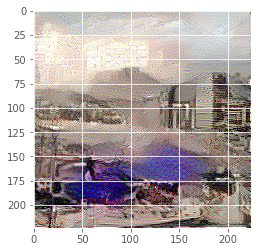

191: 1.943531, (-1.751296 - 1.872995)
192: 1.935946, (-1.756464 - 1.873110)
193: 1.928481, (-1.761553 - 1.873338)
194: 1.921122, (-1.766732 - 1.873637)
195: 1.913865, (-1.771736 - 1.873798)


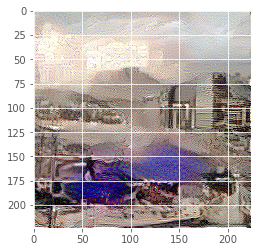

196: 1.906692, (-1.775968 - 1.873831)
197: 1.899620, (-1.780167 - 1.873718)
198: 1.892640, (-1.784588 - 1.873657)
199: 1.885748, (-1.789256 - 1.873653)
200: 1.878944, (-1.793548 - 1.873667)


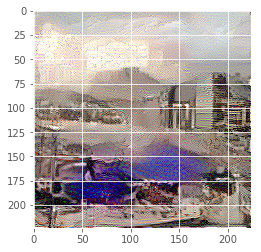

201: 1.872215, (-1.797642 - 1.873628)
202: 1.865558, (-1.801059 - 1.873667)
203: 1.858973, (-1.803728 - 1.873583)
204: 1.852469, (-1.805826 - 1.873487)
205: 1.846052, (-1.807164 - 1.873692)


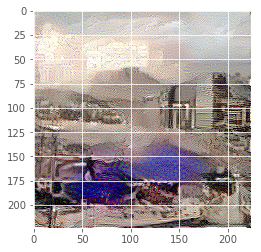

206: 1.839721, (-1.808558 - 1.874321)
207: 1.833464, (-1.809855 - 1.875065)
208: 1.827285, (-1.810855 - 1.875847)
209: 1.821167, (-1.812483 - 1.876674)
210: 1.815132, (-1.814167 - 1.877315)


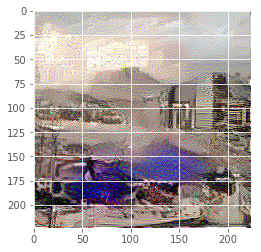

211: 1.809187, (-1.816182 - 1.877783)
212: 1.803308, (-1.818704 - 1.878005)
213: 1.797497, (-1.821289 - 1.878252)
214: 1.791761, (-1.824175 - 1.880521)
215: 1.786091, (-1.827681 - 1.882902)


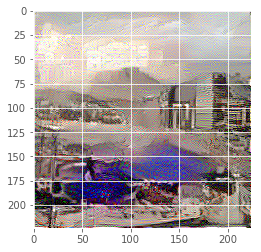

216: 1.780486, (-1.831411 - 1.885289)
217: 1.774962, (-1.835033 - 1.887539)
218: 1.769513, (-1.838232 - 1.889699)
219: 1.764131, (-1.841382 - 1.891943)
220: 1.758808, (-1.844220 - 1.894263)


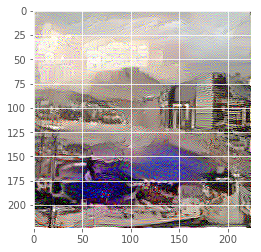

221: 1.753570, (-1.846324 - 1.896523)
222: 1.748379, (-1.847744 - 1.898777)
223: 1.743257, (-1.849051 - 1.901056)
224: 1.738191, (-1.850765 - 1.903354)
225: 1.733187, (-1.852255 - 1.905592)


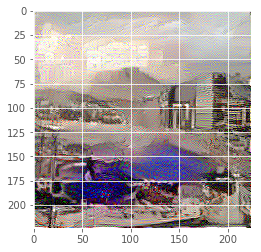

226: 1.728251, (-1.853745 - 1.907776)
227: 1.723364, (-1.855692 - 1.909903)
228: 1.718538, (-1.857402 - 1.911910)
229: 1.713766, (-1.859410 - 1.913813)
230: 1.709060, (-1.860881 - 1.915600)


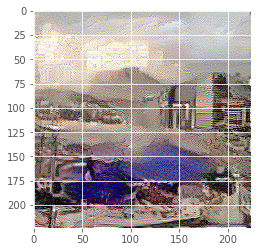

231: 1.704402, (-1.862206 - 1.917395)
232: 1.699814, (-1.862904 - 1.919207)
233: 1.695282, (-1.863476 - 1.921121)
234: 1.690830, (-1.865040 - 1.923028)
235: 1.686409, (-1.867509 - 1.924892)


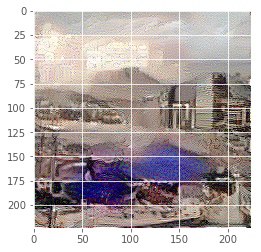

236: 1.682053, (-1.871130 - 1.926735)
237: 1.677762, (-1.875207 - 1.928532)
238: 1.673519, (-1.879054 - 1.930307)
239: 1.669332, (-1.883075 - 1.932115)
240: 1.665203, (-1.887342 - 1.933914)


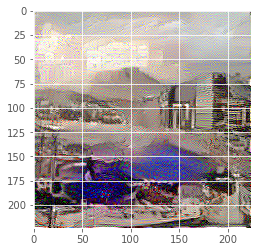

241: 1.661112, (-1.892466 - 1.935718)
242: 1.657083, (-1.897815 - 1.937459)
243: 1.653075, (-1.904084 - 1.939244)
244: 1.649112, (-1.910751 - 1.940914)
245: 1.645194, (-1.918004 - 1.942500)


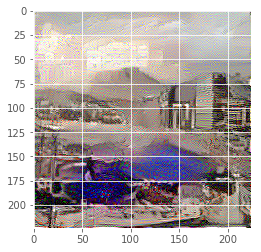

246: 1.641349, (-1.925464 - 1.944053)
247: 1.637543, (-1.932329 - 1.945521)
248: 1.633786, (-1.938457 - 1.946909)
249: 1.630064, (-1.943237 - 1.948218)
250: 1.626398, (-1.947265 - 1.949481)


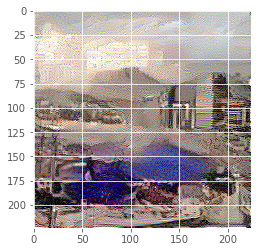

251: 1.622759, (-1.950188 - 1.950686)
252: 1.619159, (-1.952851 - 1.951913)
253: 1.615611, (-1.955346 - 1.953061)
254: 1.612092, (-1.958065 - 1.954214)
255: 1.608629, (-1.961281 - 1.955397)


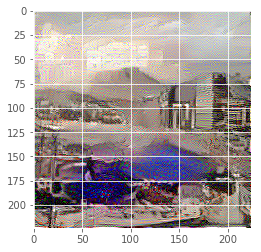

256: 1.605216, (-1.964739 - 1.956625)
257: 1.601839, (-1.967716 - 1.957838)
258: 1.598493, (-1.970315 - 1.958994)
259: 1.595171, (-1.972481 - 1.960101)
260: 1.591903, (-1.974856 - 1.961130)


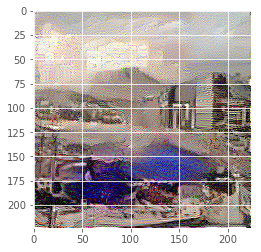

261: 1.588656, (-1.977398 - 1.962035)
262: 1.585459, (-1.979841 - 1.962892)
263: 1.582313, (-1.982276 - 1.963776)
264: 1.579190, (-1.983868 - 1.964684)
265: 1.576093, (-1.985229 - 1.965734)


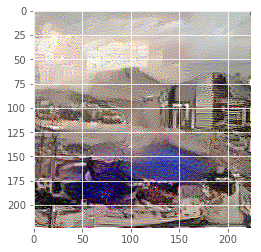

266: 1.573051, (-1.985331 - 1.966821)
267: 1.570053, (-1.986412 - 1.968013)
268: 1.567075, (-1.986474 - 1.969115)
269: 1.564101, (-1.987394 - 1.970240)
270: 1.561131, (-1.986491 - 1.971123)


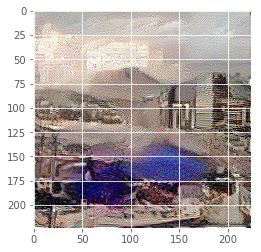

271: 1.558166, (-1.985597 - 1.972039)
272: 1.555251, (-1.983390 - 1.972828)
273: 1.552349, (-1.982698 - 1.973775)
274: 1.549506, (-1.983079 - 1.974749)
275: 1.546699, (-1.984376 - 1.975768)


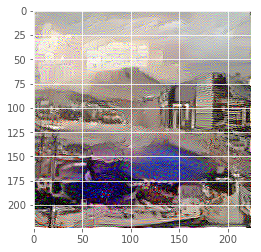

276: 1.543942, (-1.986238 - 1.976616)
277: 1.541202, (-1.988281 - 1.977323)
278: 1.538497, (-1.989331 - 1.977872)
279: 1.535819, (-1.989737 - 1.978220)
280: 1.533152, (-1.989739 - 1.978585)


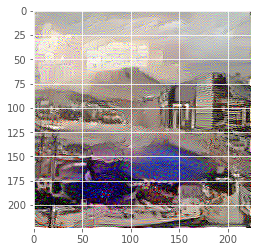

281: 1.530518, (-1.989948 - 1.978988)
282: 1.527909, (-1.990252 - 1.979436)
283: 1.525353, (-1.990107 - 1.979927)
284: 1.522856, (-1.989261 - 1.980297)
285: 1.520445, (-1.989006 - 1.980752)


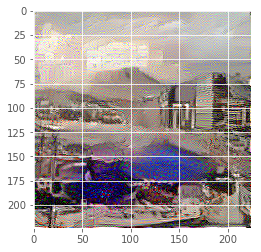

286: 1.518149, (-1.986742 - 1.981035)
287: 1.515842, (-1.986181 - 1.981478)
288: 1.513455, (-1.983808 - 1.981545)
289: 1.510810, (-1.983849 - 1.981788)
290: 1.508118, (-1.982077 - 1.981753)


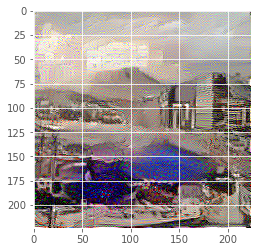

291: 1.505579, (-1.982607 - 1.981761)
292: 1.503325, (-1.984275 - 1.981803)
293: 1.501233, (-1.984941 - 1.981659)
294: 1.499095, (-1.986888 - 1.981642)
295: 1.496862, (-1.985476 - 1.981252)


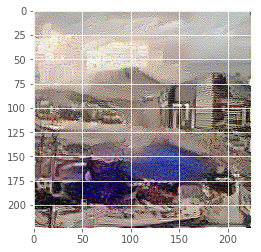

296: 1.494290, (-1.984223 - 1.981088)
297: 1.491770, (-1.979638 - 1.980693)
298: 1.489464, (-1.975412 - 1.980436)
299: 1.487418, (-1.971483 - 1.980234)
300: 1.485451, (-1.967041 - 1.979814)


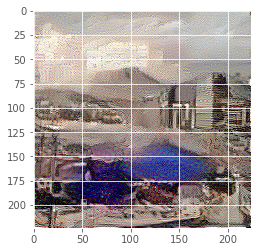

301: 1.483499, (-1.964554 - 1.979604)
302: 1.481394, (-1.960071 - 1.979077)
303: 1.478902, (-1.957759 - 1.978897)
304: 1.476531, (-1.954874 - 1.978558)
305: 1.474370, (-1.953621 - 1.978400)


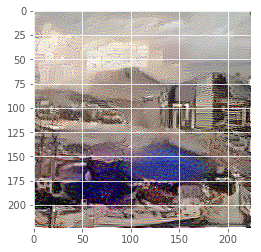

306: 1.472419, (-1.953438 - 1.978262)
307: 1.470606, (-1.953489 - 1.977803)
308: 1.468685, (-1.955255 - 1.977399)
309: 1.466619, (-1.955142 - 1.976775)
310: 1.464254, (-1.955819 - 1.976380)


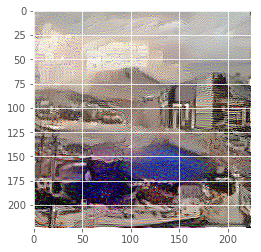

311: 1.462126, (-1.954835 - 1.975949)
312: 1.460203, (-1.953930 - 1.975573)
313: 1.458369, (-1.953290 - 1.975281)
314: 1.456645, (-1.952330 - 1.974749)
315: 1.454759, (-1.952913 - 1.974398)


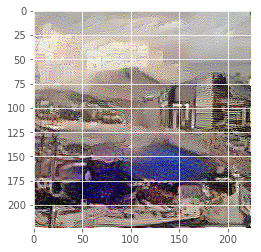

316: 1.452731, (-1.951771 - 1.973820)
317: 1.450560, (-1.951716 - 1.973455)
318: 1.448557, (-1.950939 - 1.972942)
319: 1.446714, (-1.950413 - 1.972383)
320: 1.444959, (-1.950481 - 1.971859)


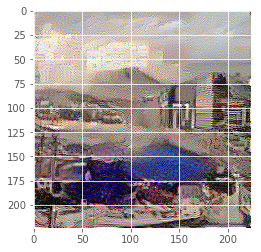

321: 1.443263, (-1.949739 - 1.971164)
322: 1.441512, (-1.949596 - 1.970637)
323: 1.439743, (-1.947120 - 1.969942)
324: 1.437793, (-1.945963 - 1.969529)
325: 1.435875, (-1.944708 - 1.968910)


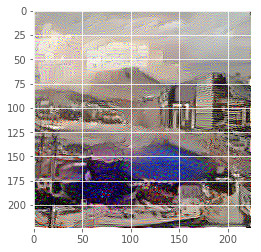

326: 1.433987, (-1.944229 - 1.968320)
327: 1.432241, (-1.944553 - 1.967619)
328: 1.430588, (-1.944339 - 1.966787)
329: 1.429016, (-1.944983 - 1.966090)
330: 1.427596, (-1.944905 - 1.965238)


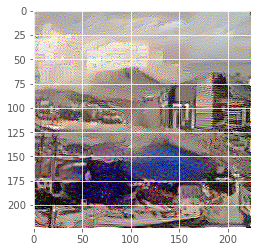

331: 1.426189, (-1.945741 - 1.964653)
332: 1.424657, (-1.945912 - 1.963661)
333: 1.422622, (-1.946695 - 1.962923)
334: 1.420658, (-1.947544 - 1.961820)
335: 1.418894, (-1.948252 - 1.960987)


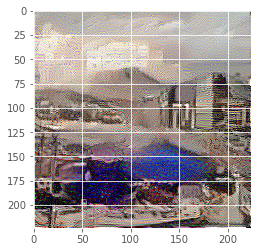

336: 1.417383, (-1.949191 - 1.960380)
337: 1.416082, (-1.950195 - 1.959815)
338: 1.414725, (-1.951533 - 1.959609)
339: 1.413343, (-1.952440 - 1.958971)
340: 1.411577, (-1.954394 - 1.958407)


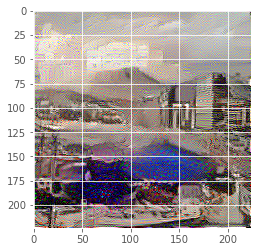

341: 1.409798, (-1.954806 - 1.957278)
342: 1.408021, (-1.955774 - 1.956269)
343: 1.406475, (-1.954851 - 1.955127)
344: 1.405130, (-1.953999 - 1.953897)
345: 1.403924, (-1.952324 - 1.952872)


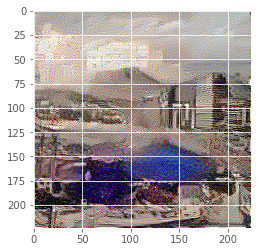

346: 1.402917, (-1.949223 - 1.951646)
347: 1.401868, (-1.947577 - 1.950746)
348: 1.400660, (-1.943827 - 1.949392)
349: 1.398596, (-1.942194 - 1.948574)
350: 1.396644, (-1.939945 - 1.947451)


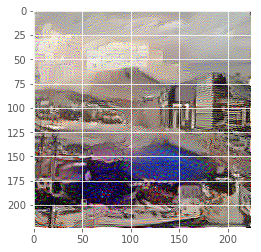

351: 1.395041, (-1.937151 - 1.946584)
352: 1.393937, (-1.936357 - 1.945859)
353: 1.393164, (-1.934274 - 1.944948)
354: 1.392142, (-1.934515 - 1.944391)
355: 1.391207, (-1.932810 - 1.943324)


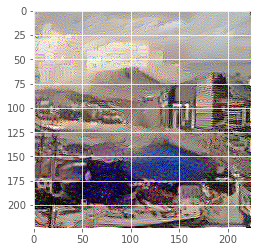

356: 1.389687, (-1.933268 - 1.942708)
357: 1.387880, (-1.930886 - 1.941529)
358: 1.385769, (-1.932023 - 1.940639)
359: 1.384336, (-1.929983 - 1.939811)
360: 1.383335, (-1.930586 - 1.938919)


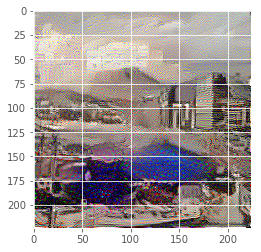

361: 1.382460, (-1.931494 - 1.938276)
362: 1.381946, (-1.930524 - 1.937064)
363: 1.380796, (-1.932471 - 1.936212)
364: 1.379327, (-1.929694 - 1.934794)
365: 1.377052, (-1.931543 - 1.933748)


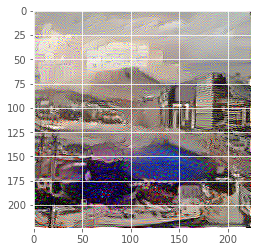

366: 1.375408, (-1.929211 - 1.932553)
367: 1.374480, (-1.927539 - 1.931486)
368: 1.373722, (-1.927383 - 1.930755)
369: 1.373148, (-1.923937 - 1.929792)
370: 1.372055, (-1.924720 - 1.929281)


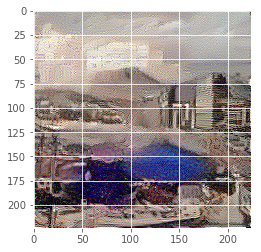

371: 1.371045, (-1.922454 - 1.928323)
372: 1.369362, (-1.923032 - 1.927875)
373: 1.367817, (-1.922254 - 1.926903)
374: 1.366061, (-1.919535 - 1.926242)
375: 1.364807, (-1.917664 - 1.925528)


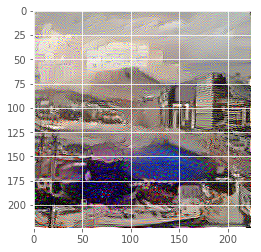

376: 1.364129, (-1.919870 - 1.924781)
377: 1.363589, (-1.919880 - 1.924317)
378: 1.363110, (-1.923903 - 1.923358)
379: 1.361774, (-1.924074 - 1.922731)
380: 1.360707, (-1.925790 - 1.921533)


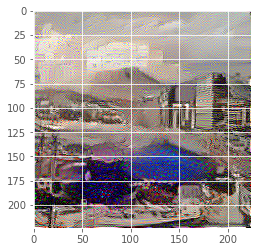

381: 1.358943, (-1.926303 - 1.920680)
382: 1.357644, (-1.927142 - 1.919547)
383: 1.356190, (-1.929427 - 1.918675)
384: 1.355010, (-1.929445 - 1.917789)
385: 1.353874, (-1.930299 - 1.916895)


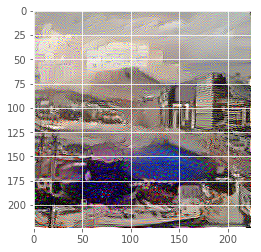

386: 1.352969, (-1.930926 - 1.916115)
387: 1.352856, (-1.933495 - 1.915009)
388: 1.352882, (-1.936358 - 1.914359)
389: 1.354023, (-1.941782 - 1.913177)
390: 1.352881, (-1.940417 - 1.912697)


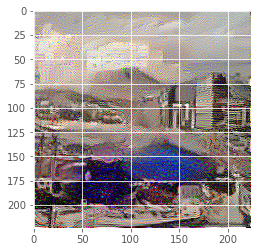

391: 1.358566, (-1.943257 - 1.911353)
392: 1.359662, (-1.937402 - 1.911115)
393: 1.386044, (-1.939692 - 1.909594)
394: 1.365974, (-1.927581 - 1.909737)
395: 1.402398, (-1.920873 - 1.908707)


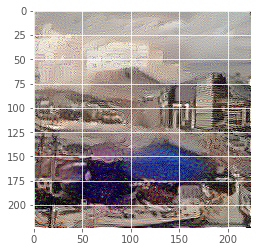

396: 1.384602, (-1.929908 - 1.909610)
397: 1.404232, (-1.940342 - 1.909028)
398: 1.386805, (-1.966581 - 1.908729)
399: 1.382328, (-1.981003 - 1.906042)
400: 1.375699, (-1.989180 - 1.902782)


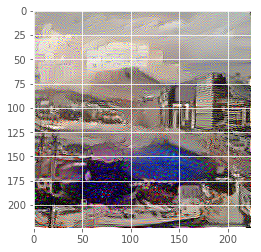

401: 1.372654, (-1.988650 - 1.899419)
402: 1.379698, (-1.977522 - 1.896259)
403: 1.374848, (-1.959241 - 1.894841)
404: 1.391171, (-1.945682 - 1.892699)
405: 1.381252, (-1.932865 - 1.892964)


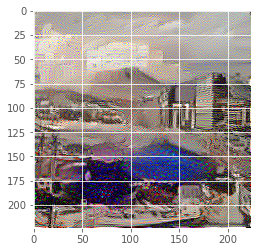

406: 1.379166, (-1.908229 - 1.891244)
407: 1.361745, (-1.907736 - 1.891035)
408: 1.358426, (-1.905065 - 1.890019)
409: 1.365149, (-1.908152 - 1.888350)
410: 1.367276, (-1.929400 - 1.887253)


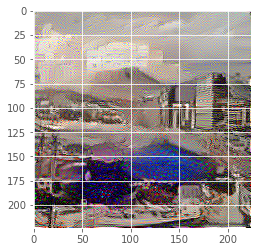

411: 1.373477, (-1.947898 - 1.883779)
412: 1.359812, (-1.958021 - 1.882113)
413: 1.360219, (-1.962222 - 1.879912)
414: 1.349690, (-1.975322 - 1.878526)
415: 1.346522, (-1.986103 - 1.877623)


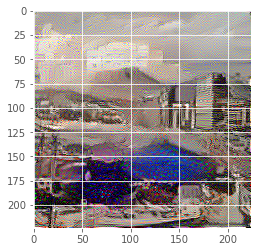

416: 1.354509, (-1.990504 - 1.875822)
417: 1.352280, (-2.002016 - 1.874512)
418: 1.364632, (-2.022923 - 1.872075)
419: 1.354841, (-2.014973 - 1.871622)
420: 1.366407, (-1.997363 - 1.870165)


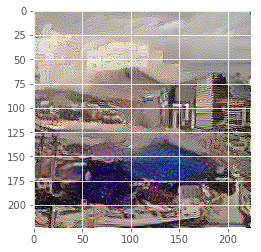

421: 1.347877, (-1.991761 - 1.871404)
422: 1.339413, (-1.973999 - 1.871623)
423: 1.342822, (-1.959460 - 1.871403)
424: 1.344131, (-1.957627 - 1.870942)
425: 1.348687, (-1.949340 - 1.868079)


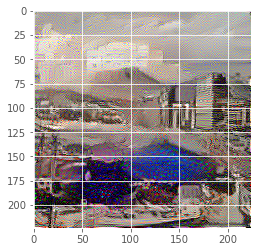

426: 1.346330, (-1.945777 - 1.866594)
427: 1.353594, (-1.935480 - 1.864700)
428: 1.335752, (-1.937243 - 1.865132)
429: 1.334440, (-1.933525 - 1.865404)
430: 1.335265, (-1.937437 - 1.866093)


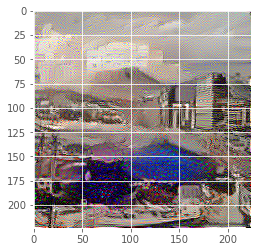

431: 1.331516, (-1.939517 - 1.866028)
432: 1.341848, (-1.945867 - 1.864064)
433: 1.347853, (-1.953330 - 1.863322)
434: 1.358424, (-1.953115 - 1.860601)
435: 1.333110, (-1.958987 - 1.861321)


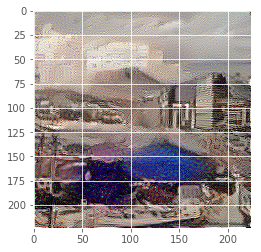

436: 1.330566, (-1.965975 - 1.861887)
437: 1.331522, (-1.965611 - 1.862635)
438: 1.328850, (-1.976442 - 1.863553)
439: 1.333228, (-1.978776 - 1.861813)
440: 1.325194, (-1.986427 - 1.860128)


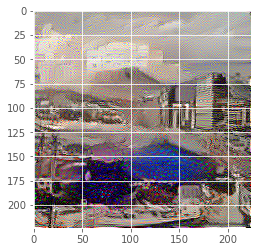

441: 1.320387, (-1.991743 - 1.858147)
442: 1.317597, (-1.998850 - 1.857322)
443: 1.316906, (-2.006987 - 1.857296)
444: 1.316060, (-2.010622 - 1.857304)
445: 1.313575, (-2.011964 - 1.857470)


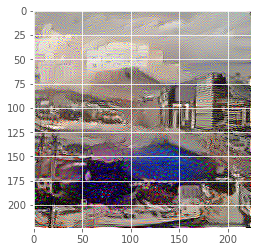

446: 1.315805, (-2.021281 - 1.856402)
447: 1.316105, (-2.016073 - 1.856207)
448: 1.316125, (-2.025207 - 1.854727)
449: 1.312358, (-2.018649 - 1.854695)
450: 1.312995, (-2.016570 - 1.853645)


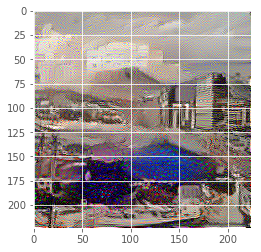

451: 1.306630, (-2.022292 - 1.853476)
452: 1.304036, (-2.032334 - 1.852923)
453: 1.302537, (-2.036002 - 1.852189)
454: 1.303500, (-2.036388 - 1.851453)
455: 1.306912, (-2.042006 - 1.849954)


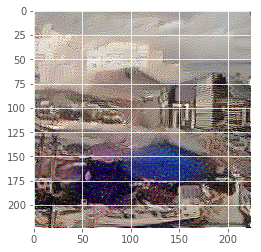

456: 1.306275, (-2.032085 - 1.849523)
457: 1.310573, (-2.032356 - 1.848158)
458: 1.305822, (-2.026109 - 1.848604)
459: 1.303182, (-2.021521 - 1.847833)
460: 1.296766, (-2.022736 - 1.848125)


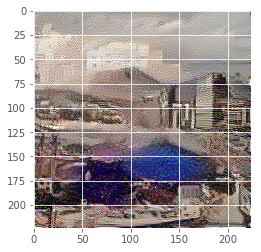

461: 1.296701, (-2.023560 - 1.847937)
462: 1.299250, (-2.024458 - 1.846864)
463: 1.298796, (-2.028698 - 1.846443)
464: 1.301062, (-2.030960 - 1.844745)
465: 1.300387, (-2.034647 - 1.844255)


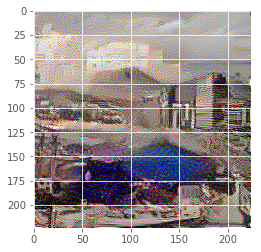

466: 1.300326, (-2.037360 - 1.843337)
467: 1.292652, (-2.029348 - 1.843706)
468: 1.292987, (-2.021247 - 1.843552)
469: 1.292100, (-2.021116 - 1.843750)
470: 1.289339, (-2.018528 - 1.843074)


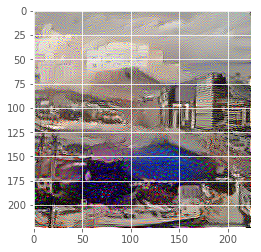

471: 1.291842, (-2.015492 - 1.841690)
472: 1.295462, (-2.026078 - 1.841472)
473: 1.297678, (-2.020157 - 1.840157)
474: 1.292266, (-2.024250 - 1.840701)
475: 1.293259, (-2.033524 - 1.840166)


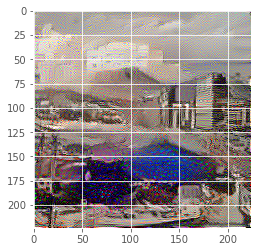

476: 1.287052, (-2.030438 - 1.839865)
477: 1.284527, (-2.028122 - 1.839448)
478: 1.286795, (-2.028754 - 1.838809)
479: 1.286212, (-2.024894 - 1.838539)
480: 1.285794, (-2.030437 - 1.837564)


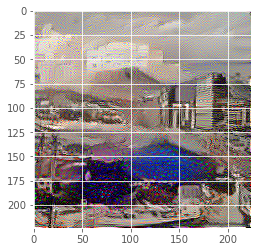

481: 1.283793, (-2.029302 - 1.837296)
482: 1.283573, (-2.034789 - 1.836283)
483: 1.282383, (-2.041898 - 1.836241)
484: 1.278910, (-2.041533 - 1.835959)
485: 1.279836, (-2.043182 - 1.835372)


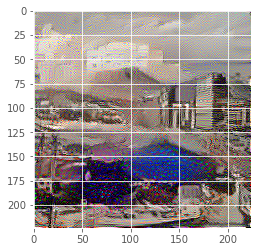

486: 1.282083, (-2.045341 - 1.835099)
487: 1.281730, (-2.044382 - 1.833439)
488: 1.280850, (-2.038197 - 1.832971)
489: 1.281022, (-2.039350 - 1.831848)
490: 1.276274, (-2.035590 - 1.831453)


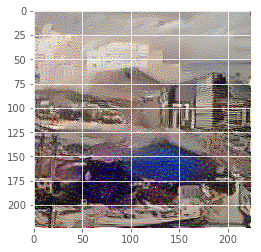

491: 1.274418, (-2.035331 - 1.831012)
492: 1.276714, (-2.039650 - 1.830274)
493: 1.277183, (-2.039356 - 1.829692)
494: 1.274512, (-2.044641 - 1.828206)
495: 1.272761, (-2.040974 - 1.827563)


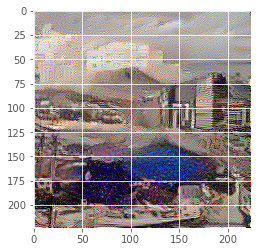

496: 1.272672, (-2.044562 - 1.826713)
497: 1.271694, (-2.048989 - 1.826489)
498: 1.269964, (-2.048827 - 1.826661)
499: 1.270496, (-2.053582 - 1.826455)
500: 1.271366, (-2.053845 - 1.826644)


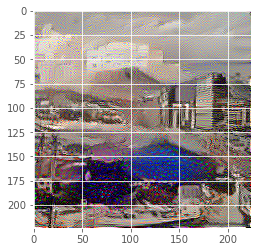

501: 1.270985, (-2.055439 - 1.825670)
502: 1.269839, (-2.055206 - 1.825786)
503: 1.268736, (-2.058365 - 1.825598)
504: 1.266033, (-2.059371 - 1.826121)
505: 1.265341, (-2.060434 - 1.826613)


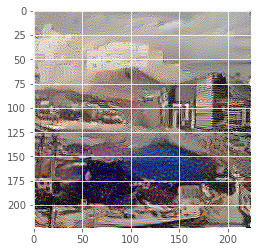

506: 1.265816, (-2.062823 - 1.826674)
507: 1.265844, (-2.062812 - 1.826767)
508: 1.265694, (-2.064844 - 1.825969)
509: 1.264747, (-2.064514 - 1.826038)
510: 1.264467, (-2.066313 - 1.825449)


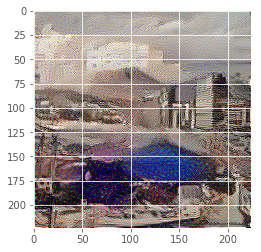

511: 1.262926, (-2.067523 - 1.825895)
512: 1.261152, (-2.067875 - 1.825618)
513: 1.260381, (-2.068669 - 1.825268)
514: 1.260528, (-2.068993 - 1.824800)
515: 1.260864, (-2.069993 - 1.823734)


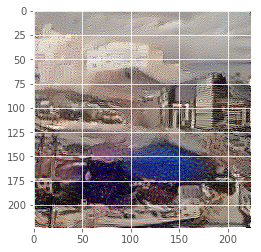

516: 1.260810, (-2.067791 - 1.823621)
517: 1.260799, (-2.070088 - 1.823012)
518: 1.259546, (-2.067224 - 1.823393)
519: 1.257827, (-2.068328 - 1.823262)
520: 1.256659, (-2.066109 - 1.823296)


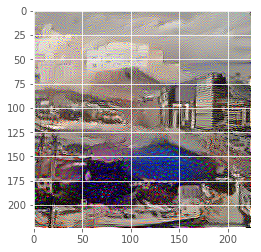

521: 1.256737, (-2.064347 - 1.823313)
522: 1.257143, (-2.066204 - 1.822904)
523: 1.257223, (-2.061382 - 1.822793)
524: 1.257511, (-2.063817 - 1.821965)
525: 1.257682, (-2.065448 - 1.822183)


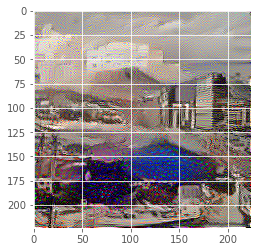

526: 1.256844, (-2.065983 - 1.821442)
527: 1.254263, (-2.067811 - 1.821492)
528: 1.253080, (-2.068431 - 1.820987)
529: 1.253562, (-2.066741 - 1.820428)
530: 1.253430, (-2.066196 - 1.820391)


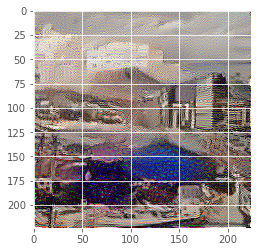

531: 1.252464, (-2.065670 - 1.819980)
532: 1.253016, (-2.062781 - 1.820299)
533: 1.254487, (-2.065587 - 1.820112)
534: 1.253551, (-2.058505 - 1.820400)
535: 1.254334, (-2.058354 - 1.819816)


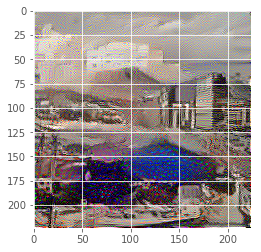

536: 1.254778, (-2.055053 - 1.820328)
537: 1.255920, (-2.054059 - 1.819448)
538: 1.254030, (-2.050348 - 1.819692)
539: 1.253818, (-2.050665 - 1.818627)
540: 1.252198, (-2.047583 - 1.818755)


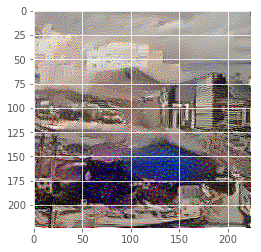

541: 1.250878, (-2.051431 - 1.818295)
542: 1.248809, (-2.051386 - 1.817872)
543: 1.248853, (-2.052057 - 1.817667)
544: 1.251687, (-2.055558 - 1.817072)
545: 1.253802, (-2.053791 - 1.817589)


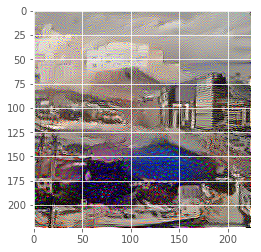

546: 1.262662, (-2.059660 - 1.816896)
547: 1.262492, (-2.051508 - 1.818293)
548: 1.290451, (-2.046308 - 1.817044)
549: 1.269738, (-2.034795 - 1.818485)
550: 1.307659, (-2.018451 - 1.817849)


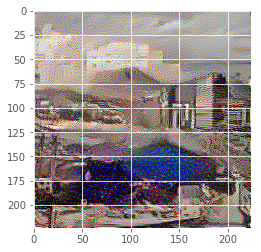

551: 1.286216, (-2.033847 - 1.819568)
552: 1.323189, (-2.045671 - 1.818764)
553: 1.289181, (-2.081237 - 1.819300)
554: 1.295418, (-2.108645 - 1.816720)
555: 1.284732, (-2.116920 - 1.814998)


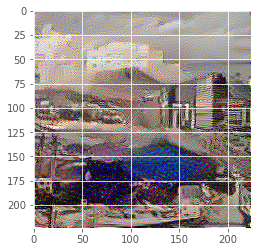

556: 1.283346, (-2.116364 - 1.811824)
557: 1.275528, (-2.102607 - 1.809205)
558: 1.272785, (-2.085912 - 1.806500)
559: 1.269300, (-2.069067 - 1.804677)
560: 1.266620, (-2.055961 - 1.803722)


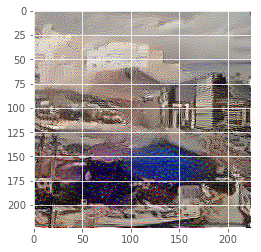

561: 1.265201, (-2.046543 - 1.802844)
562: 1.263331, (-2.039714 - 1.802210)
563: 1.272932, (-2.035495 - 1.800184)
564: 1.288036, (-2.043140 - 1.800019)
565: 1.355133, (-2.046301 - 1.796884)


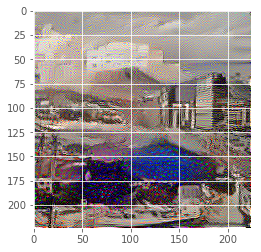

566: 1.306478, (-2.059591 - 1.799881)
567: 1.347982, (-2.074071 - 1.800291)
568: 1.296074, (-2.076444 - 1.804513)
569: 1.292987, (-2.070494 - 1.806002)
570: 1.309301, (-2.055971 - 1.804442)


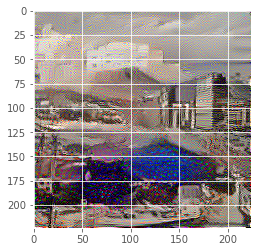

571: 1.301024, (-2.049732 - 1.802266)
572: 1.308720, (-2.033044 - 1.796024)
573: 1.290562, (-2.035686 - 1.792574)
574: 1.282423, (-2.041426 - 1.789839)
575: 1.274460, (-2.042413 - 1.789832)


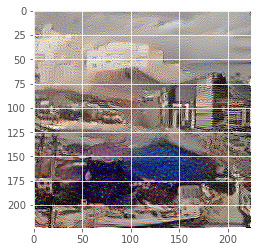

576: 1.273568, (-2.041402 - 1.791320)
577: 1.285987, (-2.048726 - 1.791773)
578: 1.286362, (-2.036008 - 1.793960)
579: 1.321166, (-2.035563 - 1.793355)
580: 1.293134, (-2.020718 - 1.796532)


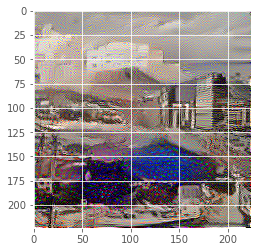

581: 1.287112, (-2.016908 - 1.796337)
582: 1.268678, (-2.013251 - 1.798541)
583: 1.274141, (-2.016374 - 1.799931)
584: 1.295872, (-2.027827 - 1.798573)
585: 1.279025, (-2.037428 - 1.799366)


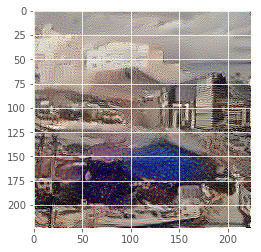

586: 1.279228, (-2.050456 - 1.797328)
587: 1.263414, (-2.063820 - 1.797429)
588: 1.261294, (-2.078505 - 1.798051)
589: 1.265866, (-2.083673 - 1.798223)
590: 1.267530, (-2.093071 - 1.800046)


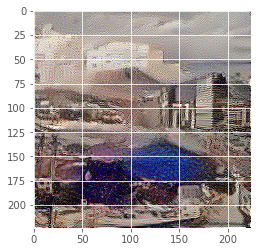

591: 1.287299, (-2.091831 - 1.798973)
592: 1.265014, (-2.106693 - 1.799207)
593: 1.271493, (-2.121095 - 1.797041)
594: 1.257629, (-2.115689 - 1.796885)
595: 1.255459, (-2.109933 - 1.795941)


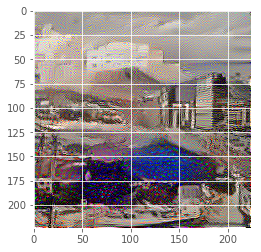

596: 1.251175, (-2.096333 - 1.796092)
597: 1.249239, (-2.085023 - 1.795263)
598: 1.254930, (-2.076544 - 1.792997)
599: 1.264693, (-2.067796 - 1.792225)
600: 1.290123, (-2.060258 - 1.789602)


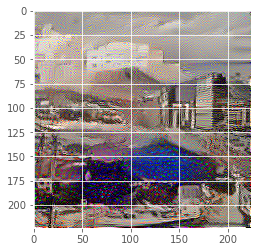

601: 1.265683, (-2.055416 - 1.791787)
602: 1.278383, (-2.060303 - 1.792639)
603: 1.255868, (-2.076198 - 1.796985)
604: 1.253762, (-2.093608 - 1.800227)
605: 1.256541, (-2.102433 - 1.801328)


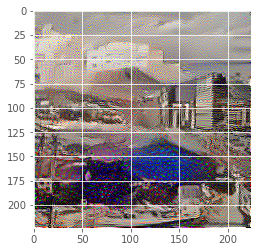

606: 1.254704, (-2.100686 - 1.800993)
607: 1.266476, (-2.106187 - 1.797277)
608: 1.257799, (-2.094618 - 1.795795)
609: 1.257630, (-2.083763 - 1.793957)
610: 1.243148, (-2.074957 - 1.795908)


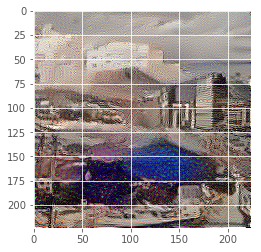

611: 1.240214, (-2.064747 - 1.798105)
612: 1.243216, (-2.056253 - 1.799772)
613: 1.245452, (-2.062914 - 1.800898)
614: 1.260160, (-2.057795 - 1.799035)
615: 1.256229, (-2.078894 - 1.799531)


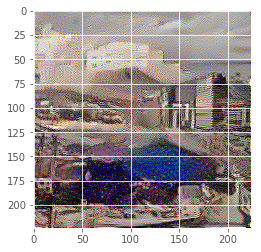

616: 1.264226, (-2.081319 - 1.797687)
617: 1.240919, (-2.083680 - 1.799195)
618: 1.236612, (-2.079293 - 1.799665)
619: 1.241803, (-2.074973 - 1.799631)
620: 1.247769, (-2.073873 - 1.799802)


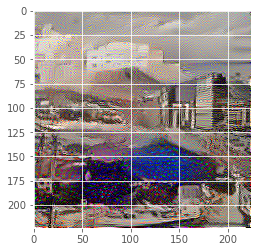

621: 1.263749, (-2.070486 - 1.796874)
622: 1.247699, (-2.073933 - 1.796337)
623: 1.239506, (-2.082664 - 1.794110)
624: 1.233799, (-2.085748 - 1.794345)
625: 1.237291, (-2.084608 - 1.795627)


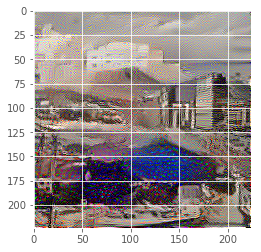

626: 1.246485, (-2.092613 - 1.794959)
627: 1.239156, (-2.086532 - 1.795971)
628: 1.238426, (-2.089921 - 1.794347)
629: 1.229655, (-2.088408 - 1.795008)
630: 1.227753, (-2.086997 - 1.795886)


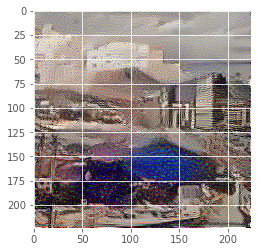

631: 1.230688, (-2.084974 - 1.796463)
632: 1.233279, (-2.084836 - 1.797314)
633: 1.241620, (-2.082474 - 1.795860)
634: 1.240287, (-2.097645 - 1.796464)
635: 1.246178, (-2.102320 - 1.794645)


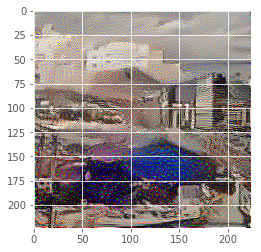

636: 1.229956, (-2.103703 - 1.796378)
637: 1.226848, (-2.106351 - 1.797342)
638: 1.227594, (-2.106493 - 1.798009)
639: 1.231352, (-2.102028 - 1.798880)
640: 1.241857, (-2.100039 - 1.797418)


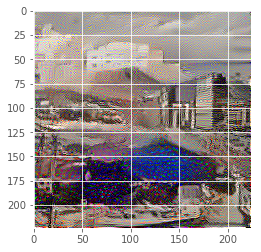

641: 1.236750, (-2.094705 - 1.798098)
642: 1.241896, (-2.092825 - 1.796872)
643: 1.227218, (-2.092485 - 1.799374)
644: 1.223654, (-2.093364 - 1.801157)
645: 1.229032, (-2.092571 - 1.802321)


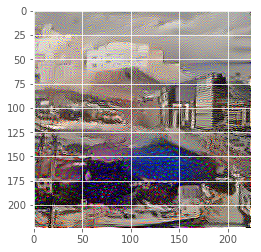

646: 1.233973, (-2.099989 - 1.803869)
647: 1.242345, (-2.097849 - 1.802129)
648: 1.228406, (-2.105336 - 1.802825)
649: 1.224220, (-2.106965 - 1.801739)
650: 1.222888, (-2.107046 - 1.802281)


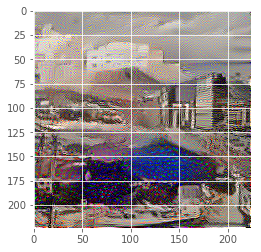

651: 1.225858, (-2.103592 - 1.803423)
652: 1.231677, (-2.104517 - 1.802565)
653: 1.227194, (-2.095584 - 1.803271)
654: 1.224649, (-2.090698 - 1.801718)
655: 1.217482, (-2.078457 - 1.802165)


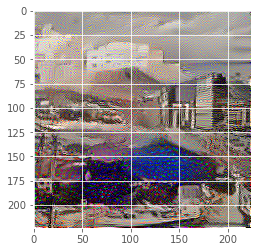

656: 1.216353, (-2.066253 - 1.802459)
657: 1.218928, (-2.058691 - 1.802378)
658: 1.219976, (-2.055837 - 1.803903)
659: 1.218654, (-2.055737 - 1.804026)
660: 1.214205, (-2.057110 - 1.805517)


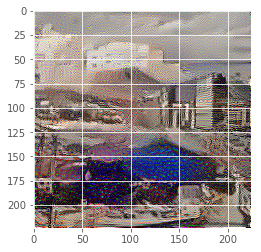

661: 1.212487, (-2.062070 - 1.806269)
662: 1.213092, (-2.067121 - 1.807059)
663: 1.213985, (-2.072054 - 1.808734)
664: 1.214604, (-2.080462 - 1.808791)
665: 1.212624, (-2.083522 - 1.810051)


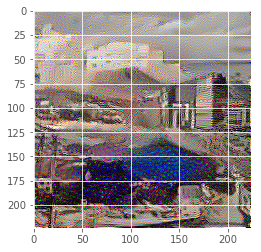

666: 1.209936, (-2.088022 - 1.810136)
667: 1.208532, (-2.089164 - 1.810997)
668: 1.209169, (-2.088623 - 1.812050)
669: 1.210456, (-2.090620 - 1.812172)
670: 1.209657, (-2.088188 - 1.813287)


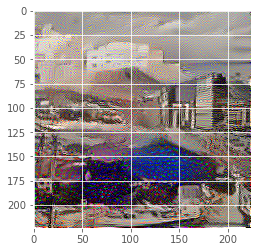

671: 1.208176, (-2.090848 - 1.812889)
672: 1.206613, (-2.090244 - 1.813515)
673: 1.206253, (-2.091105 - 1.813842)
674: 1.206336, (-2.092145 - 1.814196)
675: 1.205886, (-2.092179 - 1.814821)


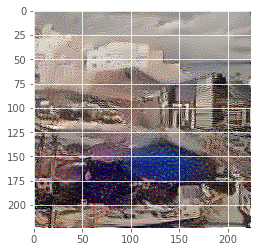

676: 1.205933, (-2.092703 - 1.814398)
677: 1.205539, (-2.092369 - 1.815034)
678: 1.204172, (-2.093733 - 1.814637)
679: 1.202855, (-2.093480 - 1.814745)
680: 1.202706, (-2.094039 - 1.814559)


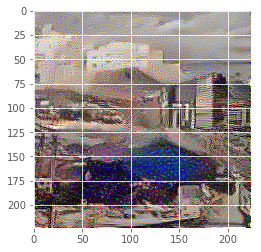

681: 1.203177, (-2.097469 - 1.813829)
682: 1.203263, (-2.097249 - 1.813910)
683: 1.202474, (-2.099060 - 1.813048)
684: 1.201693, (-2.097346 - 1.812888)
685: 1.201396, (-2.095473 - 1.812201)


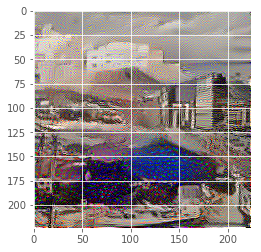

686: 1.200925, (-2.093709 - 1.811694)
687: 1.200187, (-2.090332 - 1.811200)
688: 1.199703, (-2.088194 - 1.810302)
689: 1.199672, (-2.084951 - 1.809506)
690: 1.199874, (-2.083358 - 1.808188)


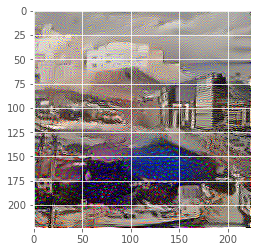

691: 1.199883, (-2.081084 - 1.807328)
692: 1.199758, (-2.080951 - 1.805959)
693: 1.199551, (-2.079822 - 1.805446)
694: 1.199110, (-2.082541 - 1.803978)
695: 1.198525, (-2.082320 - 1.803442)


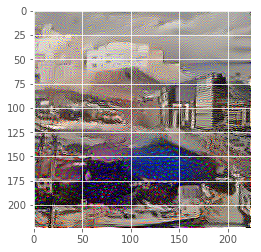

696: 1.197770, (-2.086520 - 1.802343)
697: 1.197314, (-2.087524 - 1.801538)
698: 1.197313, (-2.088275 - 1.801004)
699: 1.197654, (-2.089415 - 1.800007)
700: 1.197999, (-2.088048 - 1.799826)


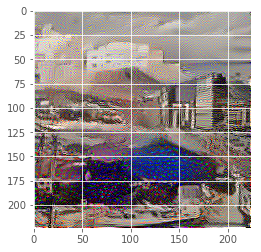

701: 1.197613, (-2.088043 - 1.798633)
702: 1.196724, (-2.088346 - 1.798224)
703: 1.196080, (-2.088196 - 1.797025)
704: 1.195913, (-2.089687 - 1.796168)
705: 1.195846, (-2.088958 - 1.795352)


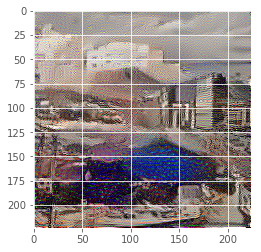

706: 1.195366, (-2.088315 - 1.794356)
707: 1.194792, (-2.085977 - 1.793846)
708: 1.194460, (-2.084407 - 1.793171)
709: 1.194636, (-2.083460 - 1.792966)
710: 1.195070, (-2.082746 - 1.792554)


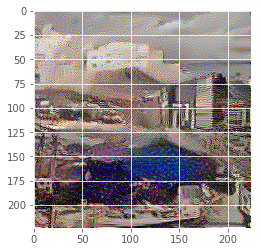

711: 1.195171, (-2.083887 - 1.792563)
712: 1.195142, (-2.082782 - 1.792126)
713: 1.194915, (-2.084345 - 1.792300)
714: 1.195098, (-2.086442 - 1.792205)
715: 1.195244, (-2.085617 - 1.792274)


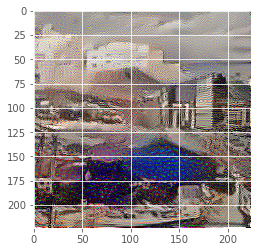

716: 1.194262, (-2.084565 - 1.792262)
717: 1.192971, (-2.082438 - 1.792303)
718: 1.192564, (-2.080686 - 1.792312)
719: 1.193401, (-2.079130 - 1.792308)
720: 1.194486, (-2.078462 - 1.792353)


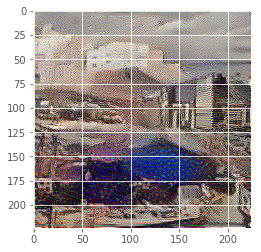

721: 1.195279, (-2.077224 - 1.792317)
722: 1.195619, (-2.076439 - 1.792361)
723: 1.196023, (-2.074601 - 1.792347)
724: 1.193734, (-2.073902 - 1.792353)
725: 1.192286, (-2.072053 - 1.792345)


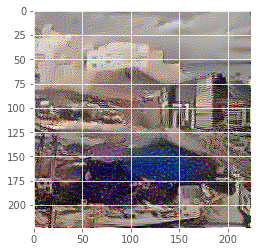

726: 1.192313, (-2.072276 - 1.792294)
727: 1.193925, (-2.072349 - 1.792325)
728: 1.195749, (-2.071789 - 1.792336)
729: 1.194868, (-2.070681 - 1.792417)
730: 1.194253, (-2.069343 - 1.792389)


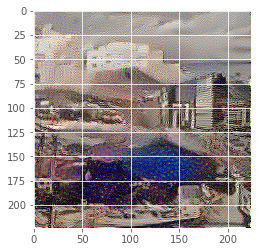

731: 1.192529, (-2.068775 - 1.792426)
732: 1.191300, (-2.069388 - 1.792354)
733: 1.191100, (-2.068881 - 1.792348)
734: 1.191378, (-2.067995 - 1.792388)
735: 1.192515, (-2.067446 - 1.792416)


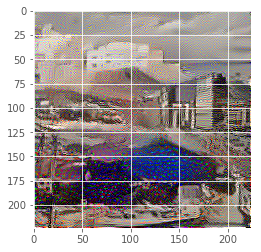

736: 1.193362, (-2.065440 - 1.792497)
737: 1.194001, (-2.066176 - 1.792520)
738: 1.192416, (-2.066731 - 1.792610)
739: 1.190564, (-2.068502 - 1.792603)
740: 1.189229, (-2.067112 - 1.792669)


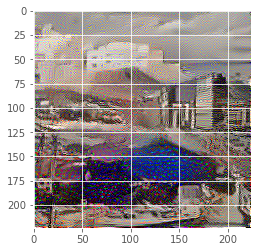

741: 1.189488, (-2.064766 - 1.792711)
742: 1.190690, (-2.062286 - 1.792736)
743: 1.191552, (-2.060662 - 1.792852)
744: 1.192237, (-2.059113 - 1.792872)
745: 1.191028, (-2.058426 - 1.793009)


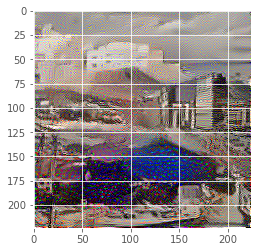

746: 1.189489, (-2.060213 - 1.793081)
747: 1.187830, (-2.060043 - 1.793201)
748: 1.187571, (-2.059517 - 1.793301)
749: 1.188465, (-2.057988 - 1.793402)
750: 1.188907, (-2.055622 - 1.793557)


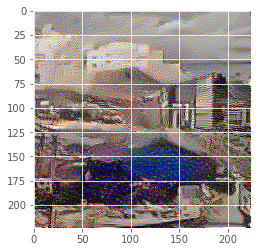

751: 1.189454, (-2.054170 - 1.793660)
752: 1.189112, (-2.051084 - 1.793845)
753: 1.188493, (-2.050174 - 1.793911)
754: 1.187471, (-2.050950 - 1.794071)
755: 1.186526, (-2.051864 - 1.794119)


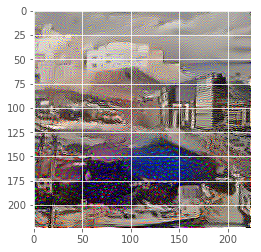

756: 1.185933, (-2.051044 - 1.794196)
757: 1.185900, (-2.049471 - 1.794279)
758: 1.186501, (-2.048076 - 1.794325)
759: 1.187259, (-2.046770 - 1.794408)
760: 1.188233, (-2.048294 - 1.794409)


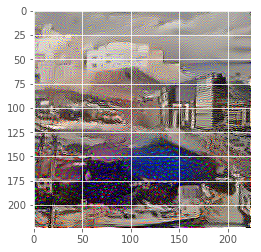

761: 1.188298, (-2.049229 - 1.794504)
762: 1.187845, (-2.053921 - 1.794478)
763: 1.185750, (-2.053653 - 1.794539)
764: 1.184612, (-2.052601 - 1.794497)
765: 1.184509, (-2.050846 - 1.794457)


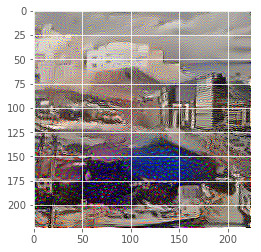

766: 1.185141, (-2.049273 - 1.794472)
767: 1.186707, (-2.049191 - 1.794458)
768: 1.188082, (-2.049037 - 1.794527)
769: 1.189790, (-2.046703 - 1.794508)
770: 1.188512, (-2.044132 - 1.794611)


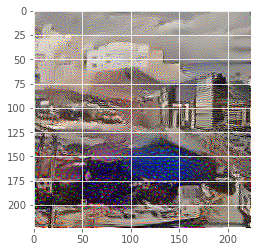

771: 1.189008, (-2.044962 - 1.794561)
772: 1.187224, (-2.045338 - 1.794643)
773: 1.186203, (-2.047652 - 1.794612)
774: 1.184749, (-2.046093 - 1.794649)
775: 1.184510, (-2.044600 - 1.794700)


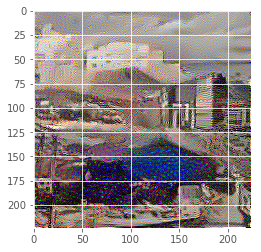

776: 1.184337, (-2.044561 - 1.794736)
777: 1.184282, (-2.043268 - 1.794865)
778: 1.184700, (-2.044683 - 1.794935)
779: 1.186054, (-2.048454 - 1.795074)
780: 1.189215, (-2.052172 - 1.795094)


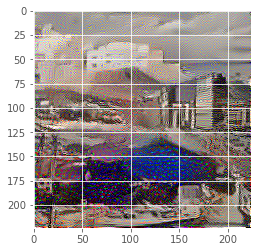

781: 1.190570, (-2.051044 - 1.795206)
782: 1.197832, (-2.046993 - 1.795200)
783: 1.195503, (-2.049896 - 1.795338)
784: 1.205314, (-2.049196 - 1.795344)
785: 1.196175, (-2.043387 - 1.795438)


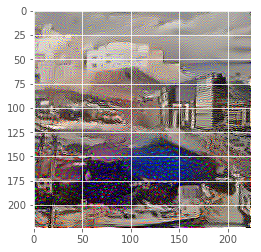

786: 1.221532, (-2.032494 - 1.795398)
787: 1.220432, (-2.045249 - 1.795511)
788: 1.291987, (-2.051425 - 1.795326)
789: 1.243567, (-2.030524 - 1.795469)
790: 1.296865, (-2.010653 - 1.795141)


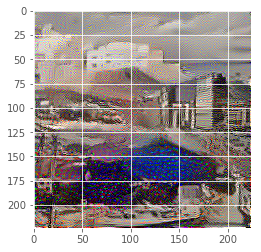

791: 1.257245, (-2.027622 - 1.795045)
792: 1.267291, (-2.031703 - 1.794722)
793: 1.249164, (-2.039283 - 1.794264)
794: 1.240999, (-2.036257 - 1.793737)
795: 1.245198, (-2.029838 - 1.793298)


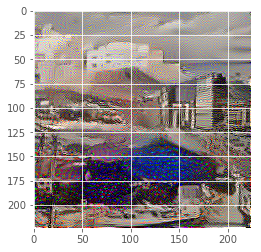

796: 1.239829, (-2.017230 - 1.793165)
797: 1.259741, (-2.015299 - 1.793138)
798: 1.266425, (-1.994918 - 1.793458)
799: 1.333483, (-1.995104 - 1.793425)
800: 1.274976, (-2.030333 - 1.793927)


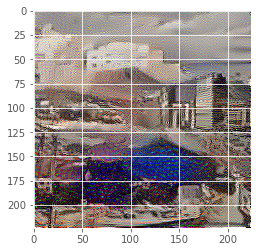

801: 1.280345, (-2.063874 - 1.793764)
802: 1.261637, (-2.056358 - 1.793650)
803: 1.255211, (-2.040102 - 1.793737)
804: 1.270014, (-2.015271 - 1.793399)
805: 1.254441, (-1.996423 - 1.793333)


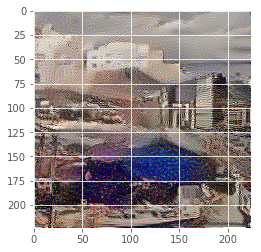

806: 1.267872, (-1.966464 - 1.793348)
807: 1.248469, (-1.969835 - 1.793595)
808: 1.248111, (-1.978644 - 1.793650)
809: 1.232378, (-1.982718 - 1.793787)
810: 1.224389, (-1.993673 - 1.793924)


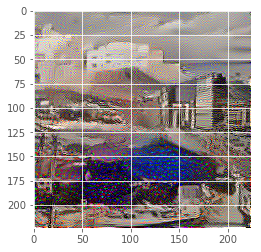

811: 1.222037, (-2.001044 - 1.794054)
812: 1.222567, (-2.003385 - 1.794375)
813: 1.232042, (-2.003642 - 1.794637)
814: 1.243408, (-1.993482 - 1.794948)
815: 1.323019, (-1.987321 - 1.795066)


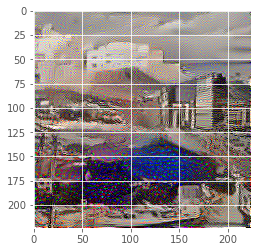

816: 1.275956, (-1.967308 - 1.795452)
817: 1.367178, (-1.955992 - 1.795443)
818: 1.268970, (-1.973469 - 1.795932)
819: 1.268717, (-1.988192 - 1.795747)
820: 1.301148, (-1.998426 - 1.794922)


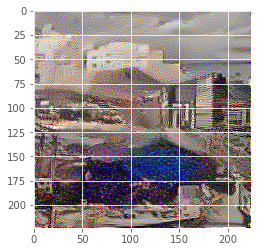

821: 1.270144, (-1.997288 - 1.794389)
822: 1.267729, (-1.999535 - 1.793823)
823: 1.258625, (-1.998534 - 1.793644)
824: 1.252487, (-1.992121 - 1.793904)
825: 1.255998, (-1.993003 - 1.793984)


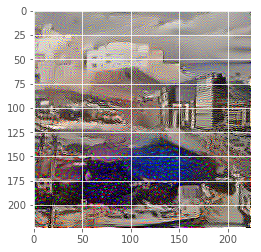

826: 1.250630, (-1.991283 - 1.794192)
827: 1.260088, (-1.993128 - 1.794317)
828: 1.236886, (-1.997900 - 1.794762)
829: 1.231712, (-2.000736 - 1.795477)
830: 1.225095, (-1.999612 - 1.796245)


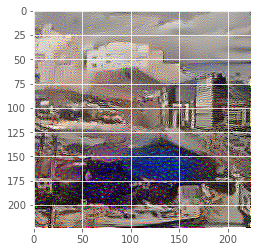

831: 1.222406, (-2.005049 - 1.796753)
832: 1.224712, (-1.998787 - 1.797218)
833: 1.219369, (-1.993613 - 1.797600)
834: 1.232483, (-1.993609 - 1.798159)
835: 1.248864, (-1.994789 - 1.798968)


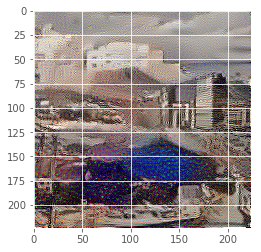

836: 1.295836, (-2.010000 - 1.799307)
837: 1.247717, (-2.018048 - 1.800165)
838: 1.238904, (-2.019330 - 1.800469)
839: 1.226642, (-2.040298 - 1.800974)
840: 1.231188, (-2.058709 - 1.801736)


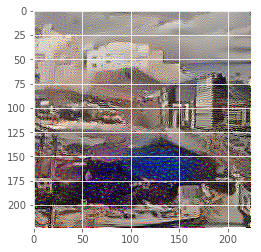

841: 1.238292, (-2.076149 - 1.802122)
842: 1.225082, (-2.082134 - 1.802620)
843: 1.226248, (-2.091316 - 1.803063)
844: 1.216375, (-2.086905 - 1.803443)
845: 1.207560, (-2.073351 - 1.803906)


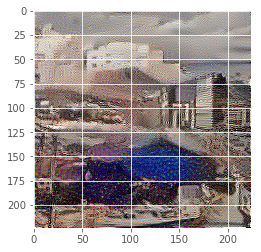

846: 1.208884, (-2.061844 - 1.804323)
847: 1.214173, (-2.043419 - 1.804872)
848: 1.238631, (-2.037984 - 1.805396)
849: 1.234337, (-2.020446 - 1.806032)
850: 1.283516, (-2.002857 - 1.806307)


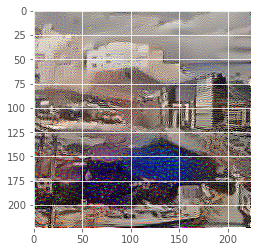

851: 1.232529, (-2.016852 - 1.806816)
852: 1.226206, (-2.035280 - 1.806898)
853: 1.222811, (-2.046861 - 1.807060)
854: 1.229762, (-2.041840 - 1.807441)
855: 1.252412, (-2.053063 - 1.807541)


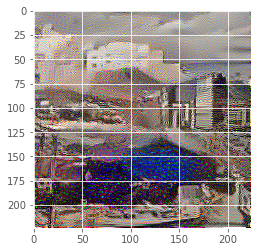

856: 1.230627, (-2.040345 - 1.807952)
857: 1.239991, (-2.047344 - 1.808381)
858: 1.218349, (-2.039443 - 1.808858)
859: 1.208051, (-2.031091 - 1.809192)
860: 1.217080, (-2.022437 - 1.809242)


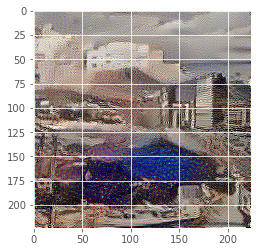

861: 1.220127, (-2.023046 - 1.809568)
862: 1.236099, (-2.014536 - 1.809972)
863: 1.215131, (-2.032671 - 1.810659)
864: 1.219174, (-2.037416 - 1.811373)
865: 1.207505, (-2.042235 - 1.812181)


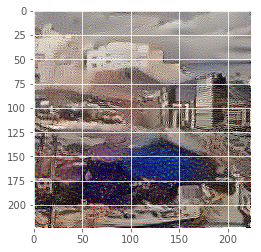

866: 1.203405, (-2.048798 - 1.812608)
867: 1.204497, (-2.048079 - 1.813169)
868: 1.203905, (-2.039805 - 1.813647)
869: 1.217531, (-2.038098 - 1.813912)
870: 1.213127, (-2.029840 - 1.814501)


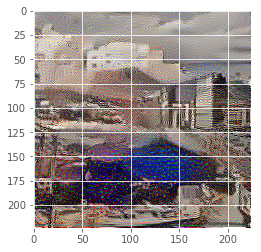

871: 1.214464, (-2.017701 - 1.814750)
872: 1.197234, (-2.014151 - 1.815226)
873: 1.196884, (-2.018221 - 1.815655)
874: 1.196886, (-2.013632 - 1.815940)
875: 1.195215, (-2.013512 - 1.816484)


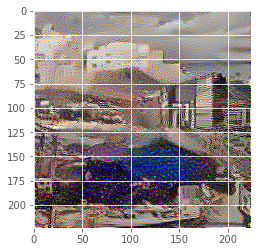

876: 1.204076, (-2.017649 - 1.816837)
877: 1.205370, (-2.012271 - 1.817199)
878: 1.210775, (-2.005551 - 1.817696)
879: 1.191333, (-2.020012 - 1.818199)
880: 1.192614, (-2.033792 - 1.818645)


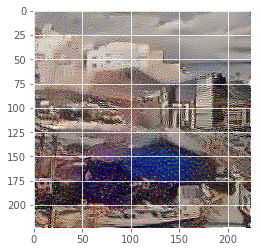

881: 1.193151, (-2.037078 - 1.819338)
882: 1.188239, (-2.037277 - 1.819790)
883: 1.184019, (-2.032701 - 1.820369)
884: 1.185219, (-2.026509 - 1.820864)
885: 1.189601, (-2.023235 - 1.821216)


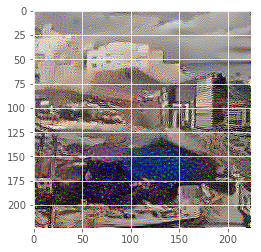

886: 1.191166, (-2.014063 - 1.821873)
887: 1.200033, (-2.012527 - 1.822259)
888: 1.198537, (-2.015871 - 1.822884)
889: 1.209053, (-2.012276 - 1.823534)
890: 1.188639, (-2.026159 - 1.824125)


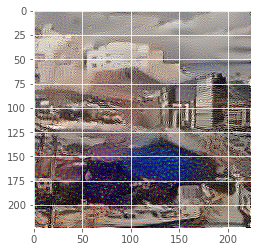

891: 1.187712, (-2.032758 - 1.824694)
892: 1.184672, (-2.042327 - 1.825289)
893: 1.184047, (-2.051798 - 1.825735)
894: 1.183426, (-2.054589 - 1.826460)
895: 1.182080, (-2.055596 - 1.827223)


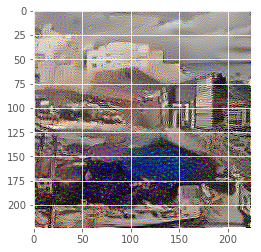

896: 1.191793, (-2.051646 - 1.827915)
897: 1.204120, (-2.045057 - 1.828877)
898: 1.218752, (-2.039094 - 1.829449)
899: 1.198076, (-2.029444 - 1.830368)
900: 1.196459, (-2.023033 - 1.831141)


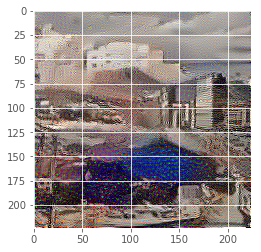

901: 1.190636, (-2.017893 - 1.831810)
902: 1.187593, (-2.013139 - 1.832706)
903: 1.192694, (-2.011204 - 1.833311)
904: 1.195284, (-2.004888 - 1.834048)
905: 1.201599, (-2.009957 - 1.834972)


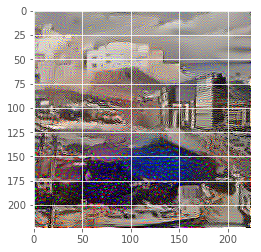

906: 1.187811, (-2.002222 - 1.836021)
907: 1.182589, (-2.003214 - 1.836745)
908: 1.179662, (-2.003940 - 1.837628)
909: 1.178978, (-2.000108 - 1.838421)
910: 1.177523, (-2.000778 - 1.839190)


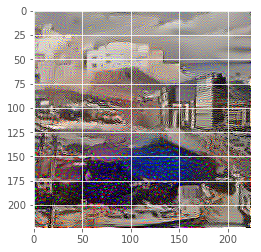

911: 1.181203, (-2.009845 - 1.840046)
912: 1.198035, (-2.007934 - 1.840770)
913: 1.202525, (-2.018617 - 1.841710)
914: 1.228061, (-2.029134 - 1.842383)
915: 1.195359, (-2.025662 - 1.843333)


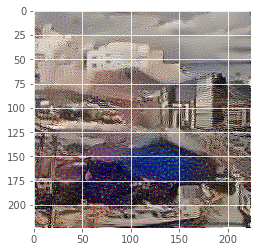

916: 1.215638, (-2.013886 - 1.844108)
917: 1.194974, (-2.025927 - 1.844757)
918: 1.191496, (-2.038484 - 1.845220)
919: 1.192465, (-2.048090 - 1.845582)
920: 1.193999, (-2.049599 - 1.846051)


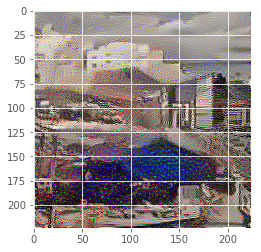

921: 1.203320, (-2.051964 - 1.846691)
922: 1.201165, (-2.049643 - 1.847524)
923: 1.217039, (-2.043546 - 1.848115)
924: 1.200878, (-2.034191 - 1.849040)
925: 1.188404, (-2.024490 - 1.849454)


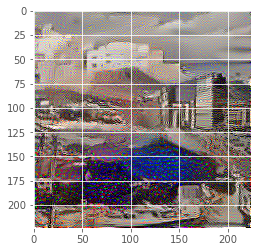

926: 1.182297, (-2.016451 - 1.850016)
927: 1.189893, (-2.009019 - 1.850643)
928: 1.204246, (-2.000892 - 1.850988)
929: 1.195829, (-2.007473 - 1.851654)
930: 1.204811, (-2.009686 - 1.852248)


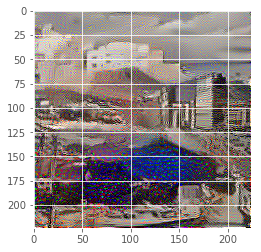

931: 1.190934, (-2.016192 - 1.852942)
932: 1.186117, (-2.014853 - 1.853772)
933: 1.179777, (-2.022210 - 1.854310)
934: 1.179908, (-2.022799 - 1.854865)
935: 1.192843, (-2.022870 - 1.855478)


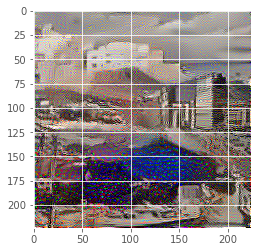

936: 1.195742, (-2.024130 - 1.856201)
937: 1.211232, (-2.036798 - 1.856923)
938: 1.201110, (-2.017474 - 1.857791)
939: 1.213261, (-2.009858 - 1.858072)
940: 1.188182, (-2.012884 - 1.858763)


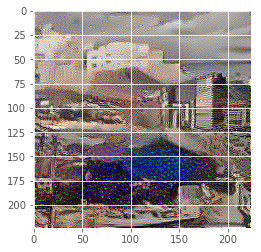

941: 1.182808, (-2.011654 - 1.859201)
942: 1.194357, (-2.010579 - 1.859597)
943: 1.197699, (-2.015978 - 1.860371)
944: 1.202765, (-2.015390 - 1.860863)
945: 1.193789, (-2.020778 - 1.861655)


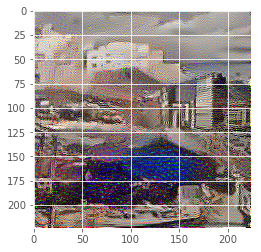

946: 1.198027, (-2.024137 - 1.862421)
947: 1.183606, (-2.024642 - 1.863003)
948: 1.175916, (-2.023773 - 1.863707)
949: 1.182673, (-2.022621 - 1.864383)
950: 1.187692, (-2.014359 - 1.865227)


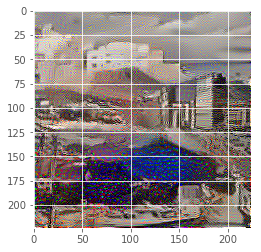

951: 1.198066, (-2.014581 - 1.866122)
952: 1.187057, (-2.011145 - 1.867068)
953: 1.202520, (-1.999786 - 1.867788)
954: 1.192230, (-2.011100 - 1.868751)
955: 1.182000, (-2.017420 - 1.869077)


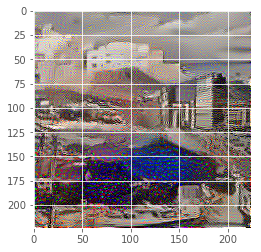

956: 1.175069, (-2.021571 - 1.869617)
957: 1.179887, (-2.027529 - 1.870155)
958: 1.180698, (-2.032232 - 1.870418)
959: 1.177364, (-2.028223 - 1.871027)
960: 1.182889, (-2.033603 - 1.871422)


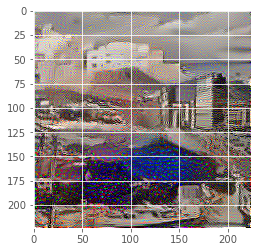

961: 1.188728, (-2.025206 - 1.871865)
962: 1.196151, (-2.021231 - 1.872478)
963: 1.177308, (-2.021344 - 1.873023)
964: 1.182744, (-2.019628 - 1.873593)
965: 1.180928, (-2.025277 - 1.874342)


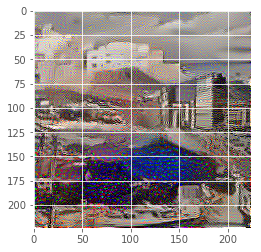

966: 1.176370, (-2.026806 - 1.874555)
967: 1.170007, (-2.028319 - 1.874985)
968: 1.172802, (-2.024964 - 1.875314)
969: 1.180775, (-2.019213 - 1.875556)
970: 1.178102, (-2.013364 - 1.876355)


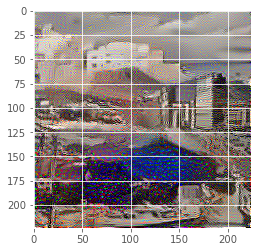

971: 1.180593, (-2.011358 - 1.876832)
972: 1.177368, (-2.005350 - 1.877239)
973: 1.173637, (-2.001234 - 1.877760)
974: 1.165111, (-1.997418 - 1.878119)
975: 1.165909, (-1.995118 - 1.878568)


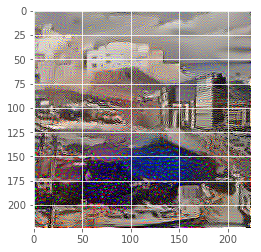

976: 1.173823, (-1.992271 - 1.879014)
977: 1.173608, (-1.994077 - 1.879436)
978: 1.182332, (-1.998541 - 1.879782)
979: 1.175571, (-1.997982 - 1.880328)
980: 1.174505, (-2.003928 - 1.880532)


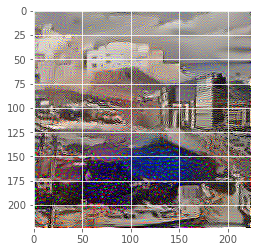

981: 1.163682, (-2.000839 - 1.880980)
982: 1.161978, (-1.999267 - 1.881207)
983: 1.166521, (-1.998996 - 1.881202)
984: 1.168711, (-1.993397 - 1.881445)
985: 1.170478, (-1.989859 - 1.881620)


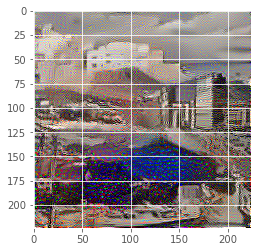

986: 1.172405, (-1.987885 - 1.881971)
987: 1.177215, (-1.980245 - 1.882445)
988: 1.164371, (-1.984497 - 1.882851)
989: 1.160106, (-1.987812 - 1.883067)
990: 1.163900, (-1.993002 - 1.883401)


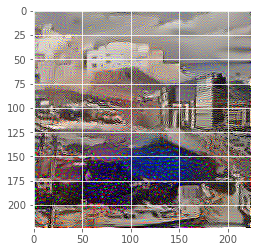

991: 1.164279, (-1.995246 - 1.883689)
992: 1.162795, (-1.998940 - 1.884103)
993: 1.165062, (-2.001366 - 1.884552)
994: 1.175409, (-2.001210 - 1.884770)
995: 1.173582, (-2.001186 - 1.885388)


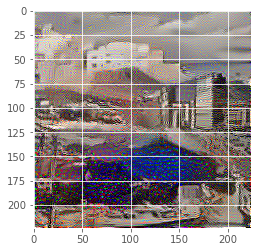

996: 1.167120, (-2.001696 - 1.885567)
997: 1.162068, (-1.994938 - 1.885899)
998: 1.165897, (-1.990032 - 1.886157)
999: 1.162341, (-1.984741 - 1.886213)


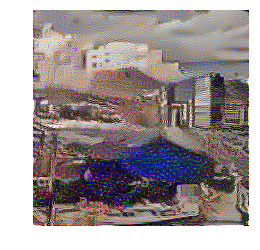

In [217]:
imgs = []
n_iterations = 1000

with tf.Session(graph=g) as sess, g.device('/cpu:0'):
    sess.run(tf.global_variables_initializer())

    # map input to noise
    og_img = net_input.eval()
    
    for it_i in range(n_iterations):
        _, this_loss, synth = sess.run([optimizer, loss, net_input], feed_dict={
                    'net/dropout_1/random_uniform:0': keep_probability,
                    'net/dropout/random_uniform:0': keep_probability})
        print("%d: %f, (%f - %f)" %
            (it_i, this_loss, np.min(synth), np.max(synth)))
        if it_i % 5 == 0:
            m = vgg16.deprocess(synth[0])
            imgs.append(m)
            plt.imshow(m)
            plt.show()
    gif.build_gif(imgs, saveto='stylenet_x.gif')

While the program crashed out too many times to want to do it again in Jupyter notebook, these style/content transfer examples are very interesting. The following constructs were used for each example

stylenet_a = style_img precedes content_img in swap iteration & only content_img is input
stylenet_b = content_img precedes style_img in swap iteration & only content_img is input
stylenet_c = style_img precedes content_img in swap iteration & norm of content_img and style_img is input
stylenet_d = content_img precedes style_img in swap iteration & norm of content_img and style_img is input

The stylenet.gif from the course, with no swapping/conflation of style and content images. The paintings, I should have mentioned, are of Velazquez and one of Picasso's versions of Velazquez's masterpiece, **Las Meninas**. I chose to reverse the process with the network, and have Picasso be the content and Velazquez's original be the style image. With or without the swapping/conflation of the style and content images, this network is quite fascinating.

Below is the style transfer with no alternation.

In [14]:
ipyd.Image(url='stylenet.gif', height=300, width=300)

stylenet_a. Note we can start to see more figure from the style painting (Velazquez's original) appear.

In [166]:
ipyd.Image(url='stylenet_e.gif', height=300, width=300)

style_net_b. 

In [167]:
ipyd.Image(url='stylenet_f.gif', height=300, width=300)

style_net_c. Note the man in the door in the Velazquez original has reappeared here in the lower center right region.

In [168]:
ipyd.Image(url='stylenet_g.gif', height=300, width=300)

style_net_d. I think this is my favorite - it most reclaims Velazquez's original with Picasso's form. Interesting that marbled texture shows up on the columns.

In [169]:
ipyd.Image(url='stylenet_h.gif', height=300, width=300)

style_net_d. 500 iterations.

In [42]:
ipyd.Image(url='stylenet_d500.gif', height=300, width=300)